In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
! pip install ultralytics pycocotools

# Import libs

In [ ]:
import torch
from ultralytics import YOLO
import matplotlib.pyplot as plt
import cv2
from PIL import Image
import os
import pandas as pd
import matplotlib
import ultralytics
import torchvision
import random
import torch
import os
import sys
import json
import shutil
from math import floor
import numpy as np
from PIL import Image
import tensorflow as tf
from pycocotools.coco import COCO
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import torchvision.transforms as T
from torch.utils.data import DataLoader
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from torchvision.transforms import functional as F
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
from torchvision.models.detection import _utils
from torchvision.models.detection.ssd import SSDClassificationHead
from torchvision.models.detection.ssd import SSD300_VGG16_Weights
import torch.optim as optim
from torch.utils.data import Dataset
import tensorrt as trt
import pathlib
import random
import modules.utils as utils
from modules.autobackend import AutoBackend

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# Code to shuffle data

* YOLO Format

In [ ]:
# # Paths to images and labels directories
# dataset_dir = './all_data/train'
# images_dir = os.path.join(dataset_dir, 'images')
# labels_dir = os.path.join(dataset_dir, 'labels')

# # Create destination folders for train and test
# train_images_dir = os.path.join(dataset_dir, 'images/train')
# train_labels_dir = os.path.join(dataset_dir, 'labels/train')
# test_images_dir = os.path.join(dataset_dir, 'images/test')
# test_labels_dir = os.path.join(dataset_dir, 'labels/test')

# # Make directories
# os.makedirs(train_images_dir, exist_ok=True)
# os.makedirs(train_labels_dir, exist_ok=True)
# os.makedirs(test_images_dir, exist_ok=True)
# os.makedirs(test_labels_dir, exist_ok=True)

# # List of images and labels
# image_files = sorted([f for f in os.listdir(images_dir) if f.endswith('.jpg')])
# label_files = sorted([f for f in os.listdir(labels_dir) if f.endswith('.txt')])

# # Check if the number of images and labels match
# assert len(image_files) == len(label_files), "Mismatch between images and labels!"

# random_seed = 42  # You can change the value to control the amount of randomness
# random.seed(random_seed)

# # Combine and shuffle the dataset (to ensure randomness in splits)
# combined = list(zip(image_files, label_files))
# random.shuffle(combined)
# image_files, label_files = zip(*combined)

# # Calculate the split index (e.g., 80% for train, 20% for test)
# total_files = len(image_files)
# train_split = floor(0.8 * total_files)

# # Split into train and test
# train_images = image_files[:train_split]
# train_labels = label_files[:train_split]
# test_images = image_files[train_split:]
# test_labels = label_files[train_split:]

# # Function to move files
# def move_files(image_list, label_list, dest_images_dir, dest_labels_dir):
#     for img, lbl in zip(image_list, label_list):
#         shutil.copy(os.path.join(images_dir, img), os.path.join(dest_images_dir, img))
#         shutil.copy(os.path.join(labels_dir, lbl), os.path.join(dest_labels_dir, lbl))

# # Move files to train and test directories
# move_files(train_images, train_labels, train_images_dir, train_labels_dir)
# move_files(test_images, test_labels, test_images_dir, test_labels_dir)

# print(f"Dataset split completed: {len(train_images)} train, {len(test_images)} test images.")


* COCO format

In [ ]:

# base_path = r'./Drowse_Detection\coco_data_shuffled' # parent path to images
# train_folder = os.path.join(base_path, 'train')  # folder that have  images
# json_file_path = os.path.join(train_folder, '_annotations.coco.json') # folder that have  images

# # Load the annotations file
# with open(json_file_path, 'r') as f:
#     coco_data = json.load(f)

# # Get all image filenames and shuffle them
# image_filenames = [img['file_name'] for img in coco_data['images']]
# random.shuffle(image_filenames)

# # Split the data (80% train, 20% test)
# split_index = int(0.8 * len(image_filenames))
# train_images = image_filenames[:split_index]
# test_images = image_filenames[split_index:]

# # Function to create new COCO JSON for split
# def create_coco_json(images_split, original_coco_data):
#     new_coco_data = original_coco_data.copy()
#     new_coco_data['images'] = [img for img in original_coco_data['images'] if img['file_name'] in images_split]
#     image_ids = [img['id'] for img in new_coco_data['images']]
#     new_coco_data['annotations'] = [ann for ann in original_coco_data['annotations'] if ann['image_id'] in image_ids]
#     return new_coco_data

# base_path = r'C:\Users\Legion\Desktop\Drowse_Detection\coco_splits_sh' # destination folder
# # Create new folders for train and test split
# train_split_folder = os.path.join(base_path, 'train_split')
# test_split_folder = os.path.join(base_path, 'test_split')
# os.makedirs(train_split_folder, exist_ok=True)
# os.makedirs(test_split_folder, exist_ok=True)

# # Save the train and test JSON files
# train_json = create_coco_json(train_images, coco_data)
# test_json = create_coco_json(test_images, coco_data)

# with open(os.path.join(train_split_folder, '_annotations.coco.json'), 'w') as f:
#     json.dump(train_json, f)

# with open(os.path.join(test_split_folder, '_annotations.coco.json'), 'w') as f:
#     json.dump(test_json, f)

# # Copy the images to the new train/test folders
# for img_file in train_images:
#     shutil.copy(os.path.join(train_folder, img_file), os.path.join(train_split_folder, img_file))

# for img_file in test_images:
#     shutil.copy(os.path.join(train_folder, img_file), os.path.join(test_split_folder, img_file))

# print("Data shuffled and split successfully!")

# Custom Functions

> * Fun for Number of image in a folder

In [ ]:
def count_images_in_folder(folder_path):
    image_extensions = ('.png', '.jpg', '.jpeg', '.gif', '.bmp', '.tiff')
    num_images = 0

    # Count the number of image files in the folder
    for root, dirs, files in os.walk(folder_path):
        num_images += len([f for f in files if f.lower().endswith(image_extensions)])

    return num_images

> * Fun for plot percentage

In [ ]:
def plot_pie_chart(labels, sizes, c, title="Image Distributions"):
    colors = c  # colors for the pie chart

    # Function to display both percentage and count
    def autopct_format(pct, allvals):
        absolute = int(pct / 100. * sum(allvals))
        return "{:.1f}% ({:d})".format(pct, absolute)

    # Plotting the pie chart
    plt.figure(figsize=(4, 4))
    plt.pie(sizes, labels=labels, colors=colors, autopct=lambda pct: autopct_format(pct, sizes),
            startangle=90, counterclock=False)
    plt.title(title)
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.

    # Show the plot
    plt.show()


> * Fun to plot one image

In [ ]:
def plot_one_image(image_url, results=None, resize_factor=0.5):
    # Load the image using PIL for better handling of PNG (with transparency)
    image = Image.open(image_url)

    # Resize the image based on the resize_factor
    original_dimensions = image.size  # (width, height)
    new_dimensions = (int(original_dimensions[0] * resize_factor), int(original_dimensions[1] * resize_factor))
    resized_image = image.resize(new_dimensions, Image.Resampling.LANCZOS)

    # If results are provided, plot the results (bounding boxes)
    if results:
        result_img = results[0].plot()  # Assuming results have a plot method for bounding boxes
        plt.figure(figsize=(7, 7))
        plt.imshow(result_img)
    else:
        # If no results, just show the resized image
        plt.figure(figsize=(10, 10))
        plt.imshow(resized_image)

    plt.axis('off')  # Hide the axis for better visualization
    plt.show()

> * plot two images

In [ ]:
def plot_two_images(image_url1, image_url2, model=None, resize_factor=0.5):

    # Load the images
    image1 = Image.open(image_url1)
    image2 = Image.open(image_url2)

    # Resize the images
    original_dimensions1 = image1.size
    original_dimensions2 = image2.size
    new_dimensions1 = (int(original_dimensions1[0] * resize_factor), int(original_dimensions1[1] * resize_factor))
    new_dimensions2 = (int(original_dimensions2[0] * resize_factor), int(original_dimensions2[1] * resize_factor))

    resized_image1 = image1.resize(new_dimensions1, Image.Resampling.LANCZOS)
    resized_image2 = image2.resize(new_dimensions2, Image.Resampling.LANCZOS)

    # Create subplots for side-by-side images
    fig, axs = plt.subplots(1, 2, figsize=(14, 7))

    # For Image 1
    if model:
        results1 = model(resized_image1)  # Perform detection on resized image
        result_img1 = results1[0].plot()  # Assuming the model provides a plot method
        axs[0].imshow(result_img1)
    else:
        axs[0].imshow(resized_image1)

    axs[0].axis('off')  # Hide axes for Image 1

    # For Image 2
    if model:
        results2 = model(resized_image2)  # Perform detection on resized image
        result_img2 = results2[0].plot()  # Assuming the model provides a plot method
        axs[1].imshow(result_img2)
    else:
        axs[1].imshow(resized_image2)

    axs[1].axis('off')  # Hide axes for Image 2

    # Adjust layout and display
    plt.tight_layout()
    plt.show()

In [ ]:
def plot_images(image_urls, model=None, resize_factor=0.5, images_per_row=3):
    num_images = len(image_urls)

    # Calculate the number of rows needed based on the images_per_row
    rows = (num_images // images_per_row) + (num_images % images_per_row > 0)

    # Create subplots for all images
    fig, axs = plt.subplots(rows, images_per_row, figsize=(15, 5 * rows))
    axs = axs.ravel()  # Flatten the 2D array of axes for easier iteration

    for i, image_url in enumerate(image_urls):
        # Load and resize the image
        image = Image.open(image_url)
        original_dimensions = image.size
        new_dimensions = (int(original_dimensions[0] * resize_factor), int(original_dimensions[1] * resize_factor))
        resized_image = image.resize(new_dimensions, Image.Resampling.LANCZOS)

        # Plot the image
        if model:
            results = model(resized_image)  # Perform detection on resized image
            result_img = results[0].plot()  # Assuming the model provides a plot method
            axs[i].imshow(result_img)
        else:
            axs[i].imshow(resized_image)

        axs[i].axis('off')  # Hide the axes

    # Hide any unused subplots
    for j in range(i + 1, len(axs)):
        axs[j].axis('off')

    # Adjust layout and display
    plt.tight_layout()
    plt.show()

In [ ]:
def plot_two_images_f_rcnn(image_url1, image_url2, model=None, resize_factor=0.5, device='cpu'):
    class_names = ['background', 'Drowse', 'Natural']

    # Load the images
    image1 = Image.open(image_url1)
    image2 = Image.open(image_url2)

    # Resize the images
    original_dimensions1 = image1.size
    original_dimensions2 = image2.size
    new_dimensions1 = (int(original_dimensions1[0] * resize_factor), int(original_dimensions1[1] * resize_factor))
    new_dimensions2 = (int(original_dimensions2[0] * resize_factor), int(original_dimensions2[1] * resize_factor))

    resized_image1 = image1.resize(new_dimensions1, Image.Resampling.LANCZOS)
    resized_image2 = image2.resize(new_dimensions2, Image.Resampling.LANCZOS)

    # Convert images to tensor format for Faster R-CNN
    transform = T.ToTensor()
    image_tensor1 = transform(resized_image1).unsqueeze(0).to(device)  # Add batch dimension
    image_tensor2 = transform(resized_image2).unsqueeze(0).to(device)

    # Move model to the specified device
    if model:
        model.to(device)

    # Create subplots for side-by-side images
    fig, axs = plt.subplots(1, 2, figsize=(14, 7))

    # Color mapping for classes
    color_map = {0: 'none',  # background (no box)
                 1: 'red',  # Drowse
                 2: 'blue'}  # Natural

    # For Image 1
    if model:
        model.eval()  # Set model to evaluation mode
        with torch.no_grad():
            results1 = model(image_tensor1)[0]  # Perform detection on Image 1
            boxes1 = results1['boxes'].cpu().numpy()
            labels1 = results1['labels'].cpu().numpy()
            scores1 = results1['scores'].cpu().numpy()

        # Plot the first image
        axs[0].imshow(resized_image1)
        axs[0].axis('off')

        # Draw bounding boxes on Image 1
        for i, box in enumerate(boxes1):
            if scores1[i] > 0.5:  # Display boxes with confidence > 0.5
                x1, y1, x2, y2 = box
                rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1, fill=False, edgecolor=color_map[labels1[i]], linewidth=2)
                axs[0].add_patch(rect)
                label = f'{class_names[labels1[i]]} ({scores1[i]:.2f})'  # Use class name
                axs[0].text(x1, y1 - 10, label, color=color_map[labels1[i]], fontsize=12, bbox=dict(facecolor='white', alpha=0.5))

    else:
        axs[0].imshow(resized_image1)

    # For Image 2
    if model:
        with torch.no_grad():
            results2 = model(image_tensor2)[0]  # Perform detection on Image 2
            boxes2 = results2['boxes'].cpu().numpy()
            labels2 = results2['labels'].cpu().numpy()
            scores2 = results2['scores'].cpu().numpy()

        # Plot the second image
        axs[1].imshow(resized_image2)
        axs[1].axis('off')

        # Draw bounding boxes on Image 2
        for i, box in enumerate(boxes2):
            if scores2[i] > 0.5:  # Display boxes with confidence > 0.5
                x1, y1, x2, y2 = box
                rect = plt.Rectangle((x1, y1), x2 - x1, y2 - y1, fill=False, edgecolor=color_map[labels2[i]], linewidth=2)
                axs[1].add_patch(rect)
                label = f'{class_names[labels2[i]]} ({scores2[i]:.2f})'  # Use class name
                axs[1].text(x1, y1 - 10, label, color=color_map[labels2[i]], fontsize=12, bbox=dict(facecolor='white', alpha=0.5))

    else:
        axs[1].imshow(resized_image2)

    # Adjust layout and display
    plt.tight_layout()
    plt.show()

> * Fun to plot random images

In [ ]:
def plot_images_from_folder(folder_path, num_images, seed=None):
    # Set the random seed for reproducibility
    if seed is not None:
        random.seed(seed)

    # List all files in the folder
    image_files = [f for f in os.listdir(folder_path) if f.endswith(('jpg', 'jpeg', 'png'))]

    # Randomly select images to display
    selected_images = random.sample(image_files, min(num_images, len(image_files)))

    # Calculate the number of rows needed, with 4 images per row
    num_columns = 4
    num_rows = (num_images + num_columns - 1) // num_columns  # Ensures enough rows

    # Plot the images
    plt.figure(figsize=(20, num_rows * 5))  # Adjust height based on the number of rows
    for idx, image_name in enumerate(selected_images):
        img_path = os.path.join(folder_path, image_name)
        img = Image.open(img_path)

        # Plotting
        plt.subplot(num_rows, num_columns, idx + 1)
        plt.imshow(img)
        plt.title(image_name)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

> * Fun to test on the camera or the video

In [ ]:

def test_fun(target , model):
# Open the video file
    cap = cv2.VideoCapture(target)

    # Check if the video opened successfully
    if not cap.isOpened():
        print("Error: Could not open video.")
        exit()

    # Get video properties
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)

    # Prepare output video writer
    out = cv2.VideoWriter('output_video.mp4', cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Run YOLOv8 inference on the frame
        results = model(frame)

        # Annotate the frame with predictions
        annotated_frame = results[0].plot()

        # Write the frame to the output video
        out.write(annotated_frame)

        # Display the frame (optional)
        cv2.imshow('YOLOv8 Inference', annotated_frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the video capture and writer
    cap.release()
    out.release()
    cv2.destroyAllWindows()

> * function to test on camera or video for faster RCNN

In [ ]:
def test_fun_rcnn(target, model):
    # Define class names (ensure this matches the number of classes in your model)
    class_names = ['background', 'Drowse', 'Natural']  # Replace with actual class names

    # Open the video file
    cap = cv2.VideoCapture(target)

    # Check if the video opened successfully
    if not cap.isOpened():
        print("Error: Could not open video.")
        exit()

    # Get video properties
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)

    # Prepare output video writer
    fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec can be adjusted if needed
    out = cv2.VideoWriter('output_video.mp4', fourcc, fps, (width, height))

    # Set the model to evaluation mode
    model.eval()
    model.cuda()  # Move the model to GPU if available

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Convert the frame to a format compatible with the model
        image_tensor = F.to_tensor(frame).unsqueeze(0).cuda()  # Use GPU if available

        # Perform inference
        with torch.no_grad():
            predictions = model(image_tensor)

        # Ensure CUDA synchronization to handle frame processing correctly
        torch.cuda.synchronize()

        # Process predictions
        boxes = predictions[0]['boxes'].cpu().numpy()
        scores = predictions[0]['scores'].cpu().numpy()
        labels = predictions[0]['labels'].cpu().numpy()

        # Draw boxes and labels on the frame
        for box, score, label in zip(boxes, scores, labels):
            if score > 0.87:  # Confidence threshold
                x1, y1, x2, y2 = map(int, box)
                class_name = class_names[int(label)]  # Get class name from index

                # Draw the bounding box
                cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

                # Draw the label and score with a background rectangle for better visibility
                label_text = f'{class_name} Score: {score:.2f}'
                text_size, _ = cv2.getTextSize(label_text, cv2.FONT_HERSHEY_SIMPLEX, 0.9, 2)
                text_width, text_height = text_size

                # Ensure text rectangle fits inside the frame
                y1_text = max(0, y1 - text_height - 10)

                cv2.rectangle(frame, (x1, y1_text), (x1 + text_width, y1), (0, 255, 0), cv2.FILLED)
                cv2.putText(frame, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.9, (255, 255, 255), 2)

        # Write the frame to the output video
        out.write(frame)

        # Display the frame (optional)
        cv2.imshow('Faster R-CNN Inference', frame)

        if cv2.waitKey(1) & 0xFF == ord('q'):
            break

    # Release the video capture and writer
    cap.release()
    out.release()
    cv2.destroyAllWindows()

# Check if CUDA is available

In [ ]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
device

'cuda'

# Plot some random images

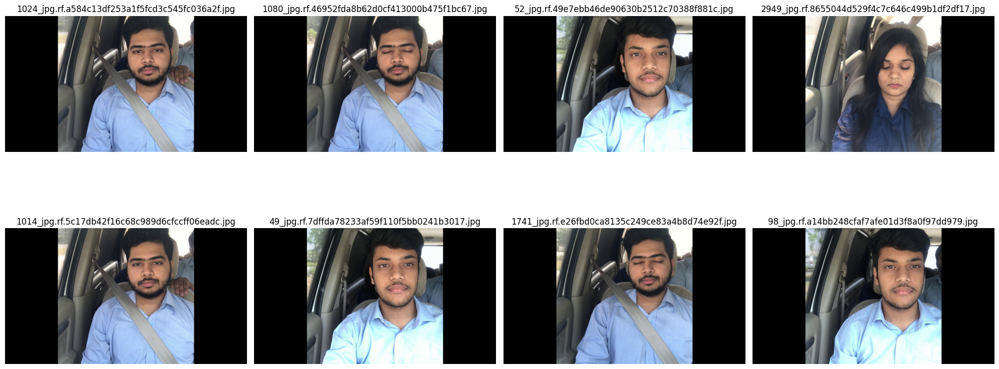

In [ ]:
folder_path = '/content/drive/MyDrive/Drowse_Pro/data_yolo_row/images/train'
num_of_images = 8
seed = 40
plot_images_from_folder(folder_path,num_of_images,seed)

# Load YOLOv8s

In [ ]:
model = YOLO('yolov8s.pt')

100%|██████████| 21.5M/21.5M [00:00<00:00, 83.8MB/s]


# Test on Image


0: 384x640 2 persons, 1 chair, 65.5ms
Speed: 2.0ms preprocess, 65.5ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


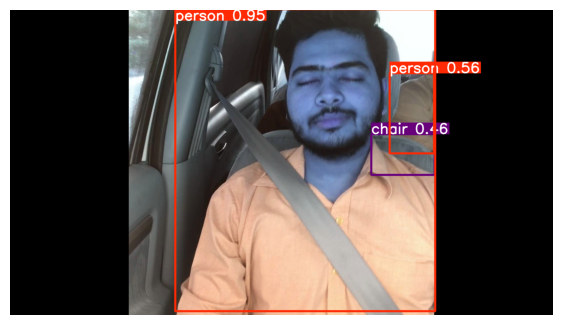

In [ ]:
url = '/content/drive/MyDrive/Drowse_Pro/data_yolo_row/images/test/1149_jpg.rf.d82cfe5bea96e8459a26280460c709dc.jpg'
img = Image.open(url)
results = model(img)
plot_one_image(url,results)

# Number of image for each class

In [ ]:
# Set the paths to the 'Drowse_clean' and 'Natural_clean' folders
drowse_clean_path = '/content/drive/MyDrive/Drowse_Pro/yolo_data_no_split/Drowse_clean'
natural_clean_path = '/content/drive/MyDrive/Drowse_Pro/yolo_data_no_split/Natural_clean'

# Get the number of images in each folder
num_drowse_images = count_images_in_folder(drowse_clean_path)
num_natural_images = count_images_in_folder(natural_clean_path)

# Print the results
print(f"Number of images in Drowse Class : {num_drowse_images}")
print(f"Number of images in Natural Class : {num_natural_images}")

Number of images in Drowse Class : 625
Number of images in Natural Class : 414


>  * Drowse (Majority) : 625 Image
>  * Natural (Minority) : 414 Image
>  * 207 diff between them

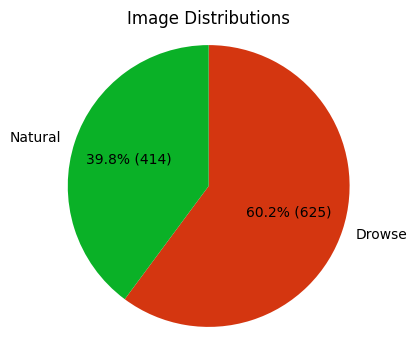

In [ ]:
# Data for pie chart
colors = ['#d43610', '#0ab127']
labels = ['Drowse', 'Natural']
sizes = [num_drowse_images, num_natural_images]

# Plot the pie chart
plot_pie_chart(labels,sizes,colors)

# Train Test Split

In [ ]:
# Set the paths to the 'Drowse_clean' and 'Natural_clean' folders
train_path = '/content/drive/MyDrive/Drowse_Pro/data_yolo_row/images/train'
test_path = '/content/drive/MyDrive/Drowse_Pro/data_yolo_row/images/test'

# Get the number of images in each folder
train_num = count_images_in_folder(train_path)
test_num = count_images_in_folder(test_path)

# Print the results
print(f"Number of images in train : {train_num}")
print(f"Number of images in test : {test_num}")

Number of images in train : 831
Number of images in test : 208


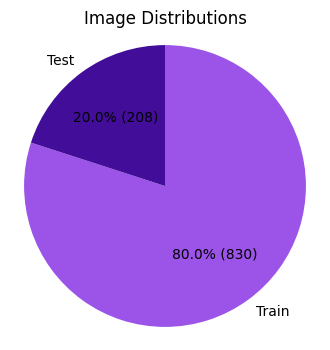

In [ ]:
# Data for pie chart
color = ['#9B53E8','#420D99']
labels = ['Train', 'Test']
sizes = [train_num, test_num]

# Plot the pie chart
plot_pie_chart(labels, sizes,color)

# Yolo files structure

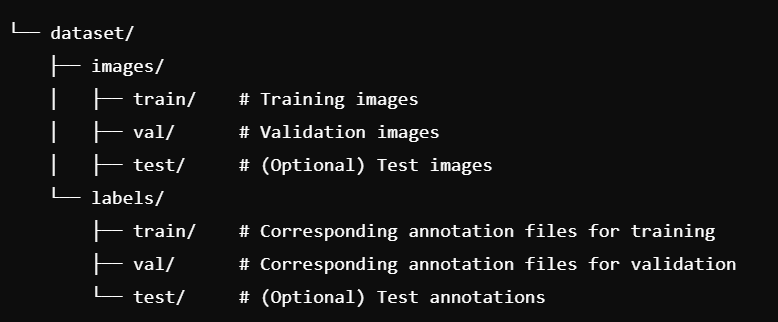

> # Fine Tuning On our custom data

# Training For 8 Epochs

In [ ]:
results = model.train(
   data='/content/drive/MyDrive/Drowse_Pro/data_yolo_row/conf.yaml',
   epochs=8,
   batch=16,
   name='yolov8s_custom',
   )

Ultralytics YOLOv8.2.97 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
engine/trainer: task=detect, mode=train, model=yolov8s.pt, data=/content/drive/MyDrive/Drowse_Pro/data_yolo_row/conf.yaml, epochs=8, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8s_custom2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show

100%|██████████| 755k/755k [00:00<00:00, 15.5MB/s]

Overriding model.yaml nc=80 with nc=2

                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics

Model summary: 225 layers, 11,136,374 parameters, 11,136,358 gradients, 28.6 GFLOPs

Transferred 64/355 items from pretrained weights
TensorBoard: Start with 'tensorboard --logdir runs/detect/yolov8s_custom2', view at http://localhost:6006/
Freezing layer 'model.22.dfl.conv.weight'


train: Scanning /content/drive/MyDrive/Drowse_Pro/data_yolo_row/labels/train... 831 images, 0 backgrounds, 0 corrupt: 100%|██████████| 831/831 [00:27<00:00, 29.72it/s]


train: New cache created: /content/drive/MyDrive/Drowse_Pro/data_yolo_row/labels/train.cache


val: Scanning /content/drive/MyDrive/Drowse_Pro/data_yolo_row/labels/test... 208 images, 0 backgrounds, 0 corrupt: 100%|██████████| 208/208 [00:13<00:00, 15.38it/s]


val: New cache created: /content/drive/MyDrive/Drowse_Pro/data_yolo_row/labels/test.cache
Plotting labels to runs/detect/yolov8s_custom2/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/yolov8s_custom2
Starting training for 8 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        1/8         0G      1.082      2.068      1.315         33        640: 100%|██████████| 52/52 [03:33<00:00,  4.11s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.77s/it]

                   all        208        208      0.953      0.877      0.969      0.886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        2/8         0G     0.5233     0.8717     0.9333         33        640: 100%|██████████| 52/52 [03:40<00:00,  4.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:13<00:00,  1.89s/it]

                   all        208        208      0.998          1      0.995      0.906



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        3/8         0G     0.4916     0.7376     0.9135         32        640: 100%|██████████| 52/52 [03:42<00:00,  4.28s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.76s/it]

                   all        208        208      0.996      0.986      0.995       0.94



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        4/8         0G     0.4397     0.5728     0.8976         27        640: 100%|██████████| 52/52 [03:40<00:00,  4.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.77s/it]

                   all        208        208      0.985          1      0.995      0.955



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        5/8         0G     0.4206     0.5103     0.8822         41        640: 100%|██████████| 52/52 [03:44<00:00,  4.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.85s/it]

                   all        208        208      0.995      0.992      0.995      0.933



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        6/8         0G     0.3978     0.4531     0.8799         37        640: 100%|██████████| 52/52 [03:44<00:00,  4.31s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.81s/it]

                   all        208        208      0.973       0.97      0.995      0.939



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        7/8         0G     0.3814     0.4132     0.8733         35        640: 100%|██████████| 52/52 [03:47<00:00,  4.37s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.64s/it]

                   all        208        208      0.999          1      0.995      0.959



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


        8/8         0G     0.3626     0.3874      0.871         24        640: 100%|██████████| 52/52 [03:41<00:00,  4.25s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:11<00:00,  1.69s/it]

                   all        208        208      0.999          1      0.995      0.965



8 epochs completed in 0.524 hours.
Optimizer stripped from runs/detect/yolov8s_custom2/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/yolov8s_custom2/weights/best.pt, 22.5MB

Validating runs/detect/yolov8s_custom2/weights/best.pt...
Ultralytics YOLOv8.2.97 🚀 Python-3.10.12 torch-2.4.0+cpu CPU (Intel Xeon 2.00GHz)
Model summary (fused): 168 layers, 11,126,358 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 7/7 [00:12<00:00,  1.82s/it]


                   all        208        208      0.999          1      0.995      0.965
                Drowse        125        125          1          1      0.995      0.967
               Natural         83         83      0.999          1      0.995      0.962
Speed: 0.3ms preprocess, 38.5ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to runs/detect/yolov8s_custom2


In [ ]:
# !cp -r /content/runs/detect/yolov8s_custom2 /content/drive/MyDrive/Drowse_Pro/src


In [ ]:
performance = pd.read_csv("/content/drive/MyDrive/Drowse_Pro/src/yolov8s_custom/results.csv")
performance

,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,1.08160,2.06840,1.31520,0.95288,0.87667,0.96929,0.88554,0.49440,1.00950,0.79254,0.000545,0.000545,0.000545
1,2,0.52326,0.87173,0.93326,0.99821,1.00000,0.99500,0.90637,0.41262,0.64636,0.76197,0.000964,0.000964,0.000964
2,3,0.49160,0.73758,0.91354,0.99620,0.98569,0.99500,0.93982,0.37784,0.53703,0.76415,0.001246,0.001246,0.001246
3,4,0.43974,0.57275,0.89765,0.98491,0.99970,0.99496,0.95543,0.32494,0.40032,0.74225,0.001048,0.001048,0.001048
4,5,0.42063,0.51031,0.88224,0.99481,0.99205,0.99500,0.93268,0.37910,0.32985,0.75077,0.000842,0.000842,0.000842
5,6,0.39783,0.45314,0.87990,0.97303,0.97015,0.99500,0.93940,0.34607,0.35834,0.74590,0.000636,0.000636,0.000636
6,7,0.38144,0.41321,0.87328,0.99939,1.00000,0.99500,0.95864,0.30165,0.28277,0.74062,0.000429,0.000429,0.000429
7,8,0.36261,0.38735,0.87099,0.99922,1.00000,0.99500,0.96460,0.28443,0.23955,0.73447,0.000223,0.000223,0.000223


# Model Evaluation

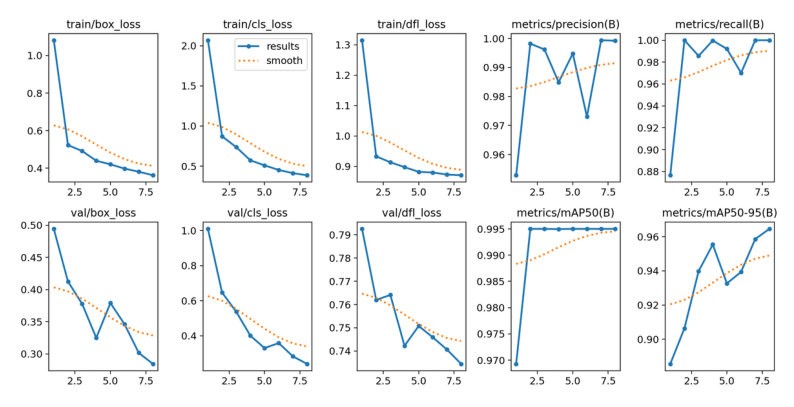

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_custom/results.png"
plot_one_image(url)

* **Confusion Matrix**

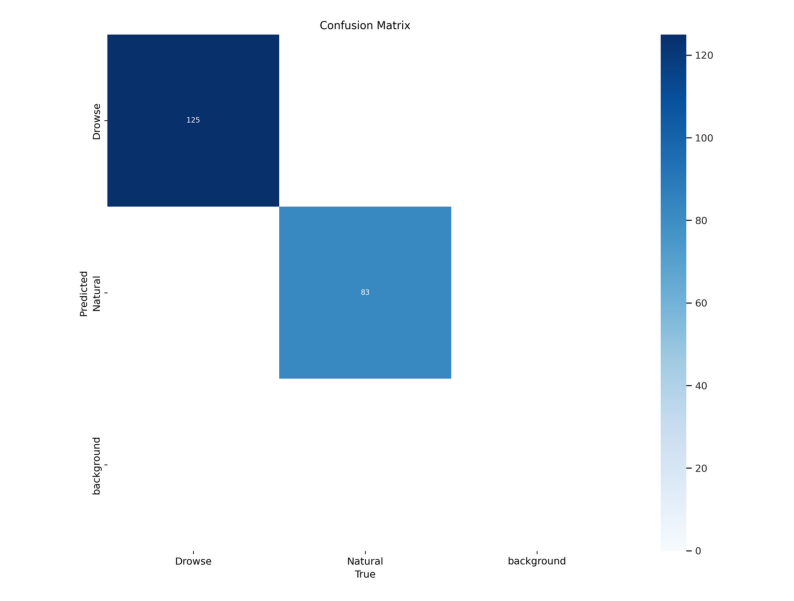

In [ ]:
l = '/content/drive/MyDrive/Drowse_Pro/src/yolov8s_custom/confusion_matrix.png'
plot_one_image(url)

 **F1_curve**

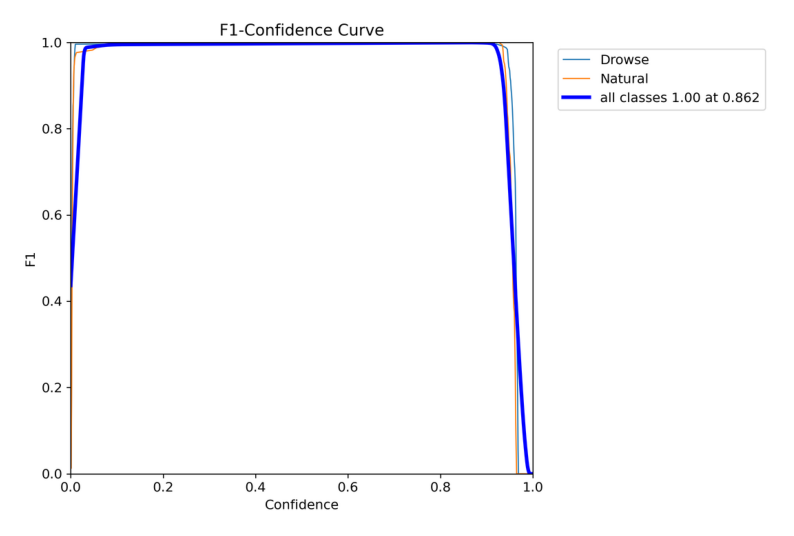

In [ ]:
url2 = '/content/drive/MyDrive/Drowse_Pro/src/yolov8s_custom/F1_curve.png'
plot_one_image(url2)

> # Prediction Sample

# True Labels

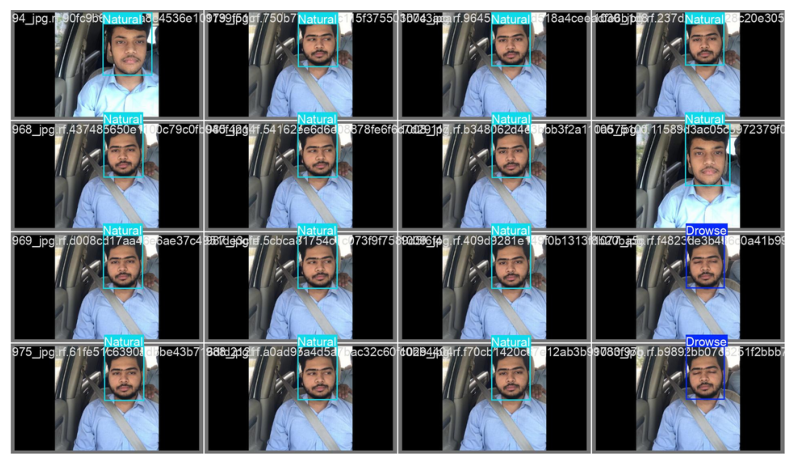

In [ ]:
url = '/content/drive/MyDrive/Drowse_Pro/src/yolov8s_custom/val_batch0_labels.jpg'
plot_one_image(url)

> # Predicted Labels

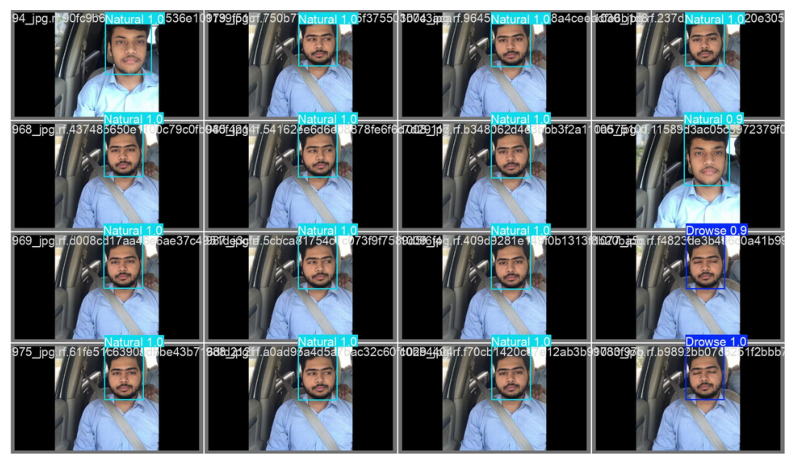

In [ ]:
url = '/content/drive/MyDrive/Drowse_Pro/src/yolov8s_custom/val_batch0_pred.jpg'
plot_one_image(url)

> # We are now reach the Base Model

# Model load

In [ ]:
modelv1 = YOLO('/content/drive/MyDrive/Drowse_Pro/src/yolov8s_custom/weights/best.pt')

# Real time test


0: 384x640 1 Natural, 436.1ms
Speed: 3.0ms preprocess, 436.1ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Natural, 432.6ms
Speed: 2.2ms preprocess, 432.6ms inference, 1.0ms postprocess per image at shape (1, 3, 384, 640)


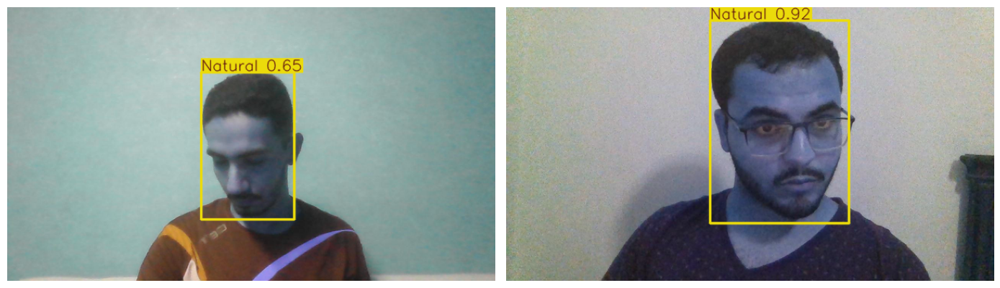

In [ ]:
url = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_01_02_04_Pro_jpg.rf.e95fc35297148664ddaad06e53dfcf9d.jpg'
url2 = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_00_46_12_Pro_jpg.rf.de7df2dd23f08e9544a1ca42b9e5f84f.jpg'

plot_two_images(url,url2,modelv1)



> # Problem State : The model performing poorly on the real time

# Data Augmentation

# Delivering each class to 725 Image

In [ ]:
# # Updated paths
# drowse_path = './row_Data/Drowse_clean'
# natural_path = './row_Data/Natural_clean'
# augmented_drowse_path = './augmented_data/Drowse_aug'
# augmented_natural_path = './augmented_data/Natural_aug'

# # Create augmented folders if they don't exist
# os.makedirs(augmented_drowse_path, exist_ok=True)
# os.makedirs(augmented_natural_path, exist_ok=True)

# # Define the data augmentation parameters
# datagen = ImageDataGenerator(
#     width_shift_range=0.1,
#     height_shift_range=0.1,
#     zoom_range=0.1,
#     horizontal_flip=True,
#     fill_mode='nearest',
#     brightness_range=[0.1, 0.75]
# )

# def augment_images(folder_path, augmented_folder_path, current_count, target_count=725):
#     missing_count = target_count - current_count

#     if missing_count <= 0:
#         print(f"No augmentation needed. Already have {current_count} images.")
#         return

#     print(f"Augmenting {missing_count} images for {augmented_folder_path}.")

#     for filename in os.listdir(folder_path):
#         if filename.endswith('.jpg') or filename.endswith('.png'):
#             img_path = os.path.join(folder_path, filename)
#             img = tf.keras.preprocessing.image.load_img(img_path)
#             x = tf.keras.preprocessing.image.img_to_array(img)
#             x = x.reshape((1,) + x.shape)  # Reshape image to (1, height, width, channels)

#             i = 0
#             for batch in datagen.flow(x, batch_size=1):
#                 if current_count >= target_count:
#                     print(f"Reached target count of {target_count} images for {augmented_folder_path}")
#                     return

#                 augmented_img = batch[0]
#                 save_path = os.path.join(augmented_folder_path, f'aug_{current_count}_{filename}')
#                 tf.keras.preprocessing.image.save_img(save_path, augmented_img)
#                 current_count += 1
#                 i += 1
#                 if i >= missing_count:  # Stop once enough images are augmented
#                     break

# # Drowse class: 625 images, augment 100 more to reach 725
# augment_images(drowse_path, augmented_drowse_path, current_count=625, target_count=725)

# # Natural class: 414 images, augment 311 more to reach 725
# augment_images(natural_path, augmented_natural_path, current_count=414, target_count=725)

# What this cell do ?
* Width Shift Range: Shifts the image horizontally by a
  percentage of the width.

* Height Shift Range: Shifts the image vertically by a
  percentage of the height.

* Zoom Range: Randomly zooms the image in or out by a set
  percentage.

* Horizontal Flip: Randomly flips the image horizontally.

* Fill Mode: Fills empty space created by shifts using the
  nearest pixel value.

* Brightness Range: Adjusts the brightness of the image within a
  specified range.

# Number of Augmented images for each class

In [ ]:
# Set the paths to the 'Drowse_clean' and 'Natural_clean' folders
drowse_aug_path = '/content/drive/MyDrive/Drowse_Pro/yolo_data_no_split/Drowse_aug'
natural_aug_path = '/content/drive/MyDrive/Drowse_Pro/yolo_data_no_split/Natural_aug'

# Get the number of images in each folder
num_drowse_aug_images = count_images_in_folder(drowse_aug_path)
num_natural_aug_images = count_images_in_folder(natural_aug_path)

# Print the results
print(f"Number of images in Drowse  aug Class : {num_drowse_aug_images}")
print(f"Number of images in Natural aug Class : {num_natural_aug_images}")

Number of images in Drowse  aug Class : 100
Number of images in Natural aug Class : 311


# After Data Augmentaion

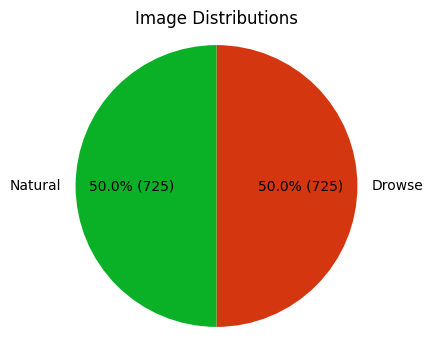

In [ ]:
total_drowse_images  = num_drowse_aug_images + num_drowse_images
total_natural_images =  num_natural_aug_images + num_natural_images
# Data for pie chart
colors = ['#d43610', '#0ab127']
labels = ['Drowse', 'Natural']
sizes = [total_drowse_images, total_natural_images]

# Plot the pie chart
plot_pie_chart(labels,sizes,colors)

> # We added more images for US to both classes to enhance the performance on real time .

> # Plot some random augmented and our images

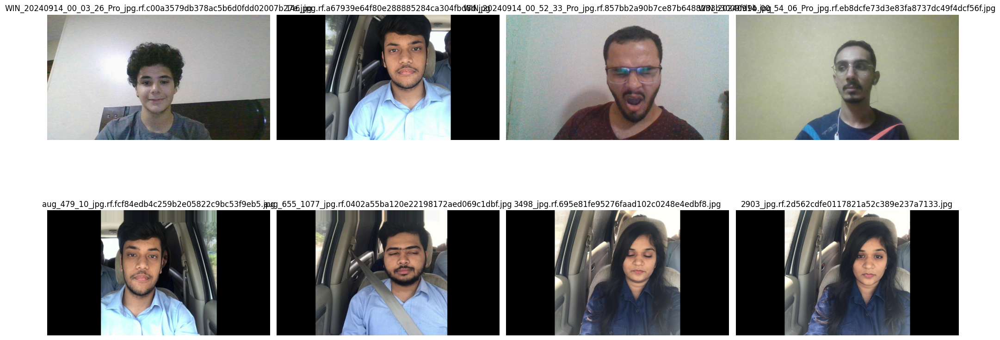

In [ ]:
folder_path = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/train'
num_of_images = 8
seed = 22
plot_images_from_folder(folder_path,num_of_images,seed)

# After adding our images

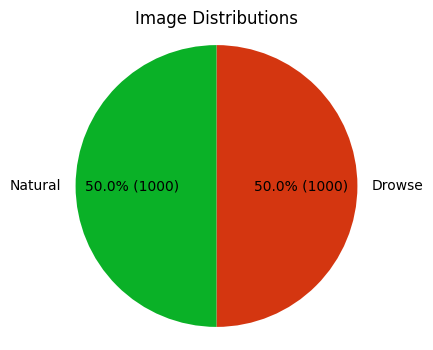

In [ ]:
total_drowse_images  = num_drowse_aug_images + num_drowse_images + 275
total_natural_images =  num_natural_aug_images + num_natural_images + 275
# Data for pie chart
colors = ['#d43610', '#0ab127']
labels = ['Drowse', 'Natural']
sizes = [total_drowse_images, total_natural_images]

# Plot the pie chart
plot_pie_chart(labels,sizes,colors)

# Train and test splits

In [ ]:
# Set the paths to the 'Drowse_clean' and 'Natural_clean' folders
train_path_aug = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/train'
test_path_aug = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test'

# Get the number of images in each folder
train_num_aug = count_images_in_folder(train_path_aug)
test_num_aug = count_images_in_folder(test_path_aug)

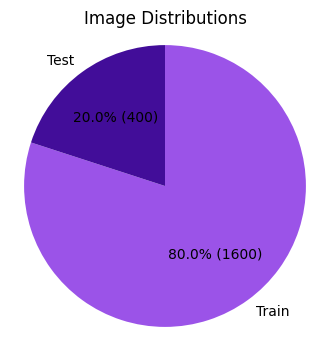

In [ ]:
# Data for pie chart
color = ['#9B53E8','#420D99']
labels = ['Train', 'Test']
sizes = [train_num_aug, test_num_aug]

# Plot the pie chart
plot_pie_chart(labels, sizes,color)

# Model after data augmentation and our data

In [ ]:
results = model.train(
   data='/content/drive/MyDrive/Drowse_Pro/data_yolo/conf_shuff.yaml',
   epochs=200,
   batch=16,
   name='yolov8s_aug',
   )

In [ ]:
perfprmance3 = pd.read_csv("/content/drive/MyDrive/Drowse_Pro/src/yolov8s_aug/results.csv")
perfprmance3

,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
0,1,0.31002,0.24679,0.84428,0.99297,0.99263,0.99396,0.96648,0.27566,0.17434,0.75283,0.000550,0.000550,0.000550
1,2,0.34548,0.30004,0.86446,0.98143,0.98420,0.99283,0.94665,0.32578,0.23272,0.76904,0.001100,0.001100,0.001100
2,3,0.36586,0.33696,0.86907,0.98151,0.99193,0.99289,0.95288,0.33031,0.23579,0.76784,0.001645,0.001645,0.001645
3,4,0.38309,0.34127,0.88152,0.98075,0.99522,0.99293,0.94999,0.34390,0.23143,0.77784,0.001642,0.001642,0.001642
4,5,0.39045,0.36289,0.87984,0.98615,0.97998,0.99215,0.94034,0.36601,0.27977,0.78016,0.001634,0.001634,0.001634
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
195,196,0.18963,0.09964,0.77134,0.99707,0.99761,0.99458,0.98214,0.21628,0.11134,0.74338,0.000058,0.000058,0.000058
196,197,0.18842,0.09885,0.77137,0.99709,0.99761,0.99464,0.98102,0.21709,0.11150,0.74347,0.000050,0.000050,0.000050
197,198,0.18840,0.09691,0.77535,0.99710,0.99761,0.99458,0.98217,0.21720,0.11072,0.74376,0.000041,0.000041,0.000041
198,199,0.18789,0.09690,0.77074,0.99710,0.99761,0.99453,0.98216,0.21669,0.11117,0.74362,0.000033,0.000033,0.000033


# Model load

In [ ]:
model_aug = YOLO('/content/drive/MyDrive/Drowse_Pro/src/yolov8s_aug/weights/best.pt')

> # Model Evaluation

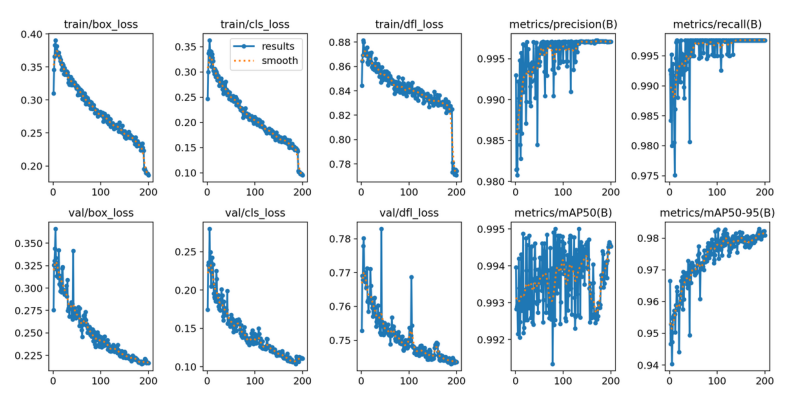

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_aug/results.png"
plot_one_image(url)

# 1. **Confusion matrix**

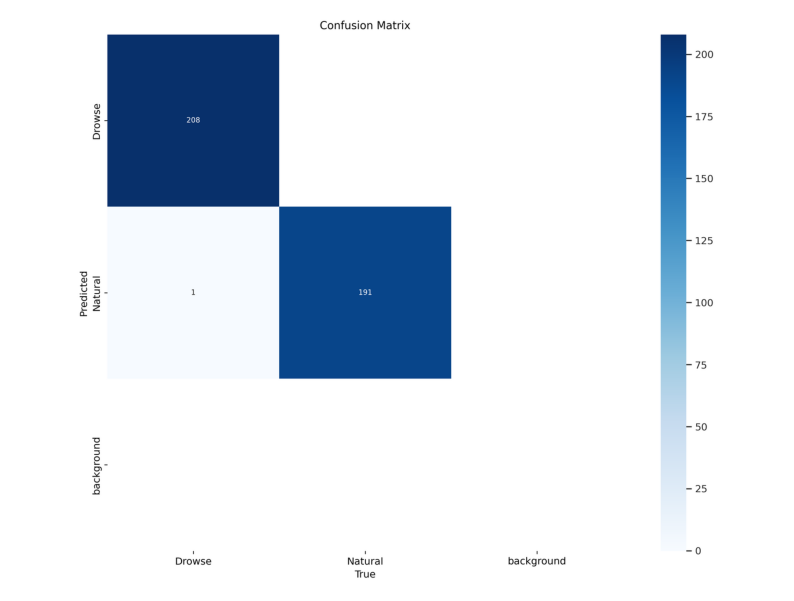

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_aug/confusion_matrix.png"
plot_one_image(url)

# 2. **F1-curve**

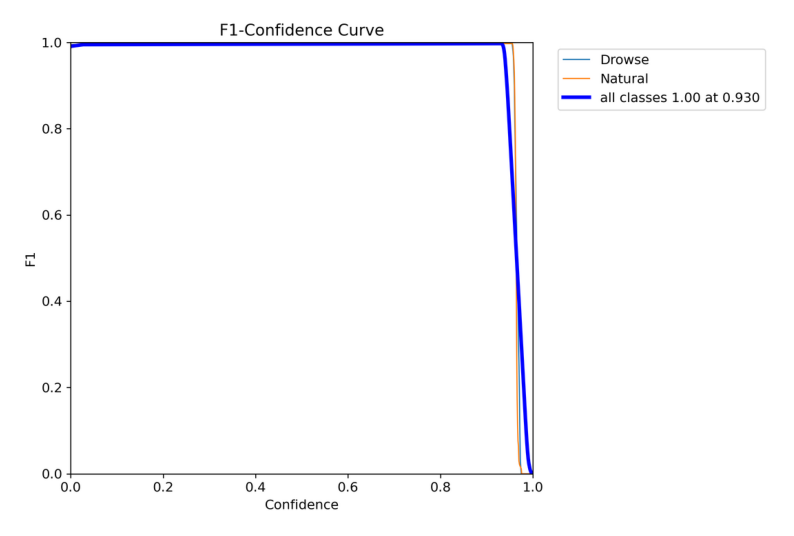

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_aug/F1_curve.png"
plot_one_image(url)

> # Model Test


0: 384x640 1 Drowse, 691.5ms
Speed: 2.2ms preprocess, 691.5ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Natural, 503.3ms
Speed: 3.4ms preprocess, 503.3ms inference, 0.9ms postprocess per image at shape (1, 3, 384, 640)


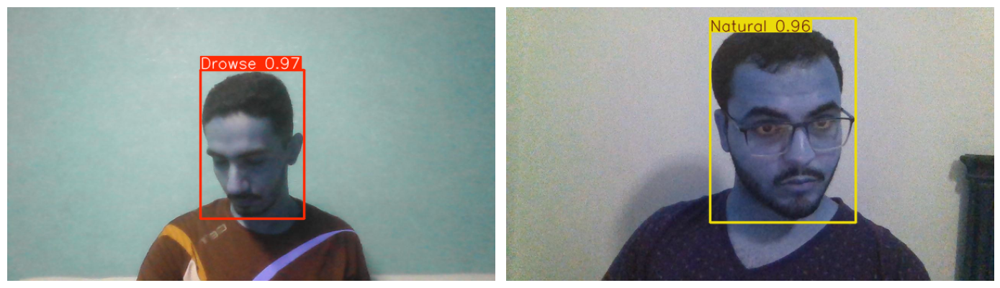

In [ ]:
url3 = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_01_02_04_Pro_jpg.rf.e95fc35297148664ddaad06e53dfcf9d.jpg'
url4 = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_00_46_12_Pro_jpg.rf.de7df2dd23f08e9544a1ca42b9e5f84f.jpg'

plot_two_images(url3,url4,model_aug)


# Grad Cam (which part supporting our decision)

> # **Note** : So helpful Repo as YOLO doesn't support Grad cam directly
> # ( https://github.com/rigvedrs/YOLO-V8-CAM/tree/main )

In [ ]:
!git clone https://github.com/rigvedrs/YOLO-V8-CAM.git

Cloning into 'YOLO-V8-CAM'...
remote: Enumerating objects: 78, done.
remote: Counting objects: 100% (21/21), done.
remote: Compressing objects: 100% (18/18), done.
remote: Total 78 (delta 7), reused 11 (delta 3), pack-reused 57 (from 1)
Receiving objects: 100% (78/78), 29.77 MiB | 20.74 MiB/s, done.
Resolving deltas: 100% (20/20), done.


In [ ]:
!pip install ttach

In [ ]:
%cd /content/YOLO-V8-CAM

/content/YOLO-V8-CAM


In [ ]:
from yolo_cam.eigen_cam import EigenCAM
from yolo_cam.utils.image import show_cam_on_image, scale_cam_image

In [ ]:
img = cv2.imread('/content/drive/MyDrive/Drowse_Pro/data_yolo/images/train/WIN_20240914_00_43_14_Pro_jpg.rf.116df33a7f698aee83551dc87e194559.jpg')
img = cv2.resize(img, (640, 640))
rgb_img = img.copy()
img = np.float32(img) / 255


img2 = cv2.imread('/content/drive/MyDrive/Drowse_Pro/data_yolo/images/train/1466_jpg.rf.92efa3416d060bd1f5fa40e49335051e.jpg')
img2 = cv2.resize(img2, (640, 640))
rgb_img2 = img2.copy()
img2 = np.float32(img2) / 255

In [ ]:
target_layer = model_aug.model.model[22].cv3[2] # This accesses the last convolutional layer in the third detection head.


0: 640x640 1 Natural, 1003.4ms
Speed: 4.5ms preprocess, 1003.4ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Natural, 1052.2ms
Speed: 3.1ms preprocess, 1052.2ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


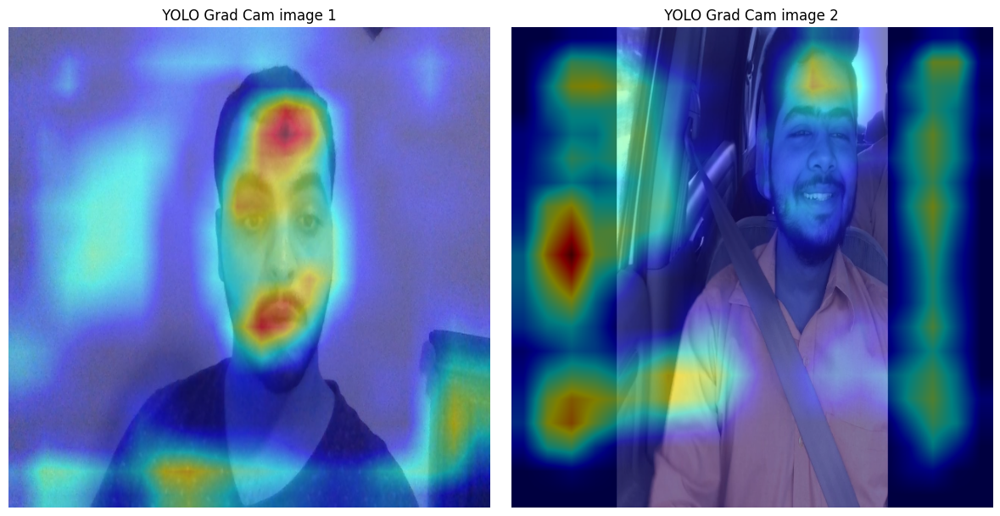

In [ ]:

# Display the images side by side using subplots
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# First CAM image
cam = EigenCAM(model_aug, target_layer, task='od')
grayscale_cam = cam(rgb_img)[0, :, :]
cam_image = show_cam_on_image(img, grayscale_cam, use_rgb=True)

ax[0].imshow(cam_image)
ax[0].set_title(" YOLO Grad Cam image 1 ")
ax[0].axis('off')

# Second CAM image
cam2 = EigenCAM(model_aug, target_layer, task='od')
grayscale_cam2 = cam2(rgb_img2)[0, :, :]
cam_image2 = show_cam_on_image(img2, grayscale_cam2, use_rgb=True)

ax[1].imshow(cam_image2)
ax[1].set_title(" YOLO Grad Cam image 2 ")
ax[1].axis('off')

# Display the images side by side
plt.tight_layout()
plt.show()

> # Faster R-CNN

# torch functions

In [ ]:
class COCODataset(torch.utils.data.Dataset):
    def __init__(self, root, annotation, transforms=None):
        super().__init__()
        self.root = root
        self.coco = COCO(annotation)
        self.ids = list(self.coco.imgs.keys())
        self.transforms = transforms

    def __getitem__(self, index):
        coco = self.coco
        img_id = self.ids[index]
        ann_ids = coco.getAnnIds(imgIds=img_id)
        anns = coco.loadAnns(ann_ids)
        img_info = coco.loadImgs(img_id)[0]
        path = img_info['file_name']

        # Load image
        img = Image.open(os.path.join(self.root, path)).convert("RGB")

        # Get bounding boxes and labels
        boxes = []
        labels = []
        for ann in anns:
            bbox = ann['bbox']
            # COCO format is [x, y, width, height], we convert it to [x_min, y_min, x_max, y_max]
            bbox = [bbox[0], bbox[1], bbox[0] + bbox[2], bbox[1] + bbox[3]]
            boxes.append(bbox)
            labels.append(ann['category_id'])

        boxes = torch.as_tensor(boxes, dtype=torch.float32)
        labels = torch.as_tensor(labels, dtype=torch.int64)
        target = {"boxes": boxes, "labels": labels}

        if self.transforms:
            img = self.transforms(img)

        return img, target

    def __len__(self):
        return len(self.ids)

# Load and fine-tune Faster R-CNN
def get_model(num_classes):
    # Load a pre-trained model
    model = fasterrcnn_resnet50_fpn(pretrained=True)
    in_features = model.roi_heads.box_predictor.cls_score.in_features

    # Modify the classifier head for the custom number of classes
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)
    return model

def get_transform():
    transforms = []
    transforms.append(T.ToTensor())  # Convert image to tensor
    return T.Compose(transforms)

# Model training

In [ ]:
# Paths to the dataset
root = '/content/drive/MyDrive/Drowse_Pro/coco_splits/train_split'  # Path to the folder containing images
annotation = '/content/drive/MyDrive/Drowse_Pro/coco_splits/train_split/_annotations.coco.json'  # Path to the COCO annotation file

# Create the dataset
dataset = COCODataset(root=root, annotation=annotation, transforms=get_transform())

# DataLoader to handle batching and shuffling
data_loader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=4, collate_fn=lambda x: tuple(zip(*x)))

# Define the model
num_classes = 3  # 2 classes (Drowse, Natural) + 1 for background
model = get_model(num_classes)

# Move model to the right device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)

# Define optimizer and learning rate
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

# Learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# Training loop
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    running_loss = 0.0
    for images, targets in data_loader:
        images = list(img.to(device) for img in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        optimizer.zero_grad()
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())
        losses.backward()
        optimizer.step()

        running_loss += losses.item()

    print(f"Epoch {epoch + 1}, Loss: {running_loss / len(data_loader)}")

    # Update the learning rate
    lr_scheduler.step()

print("Training complete.")

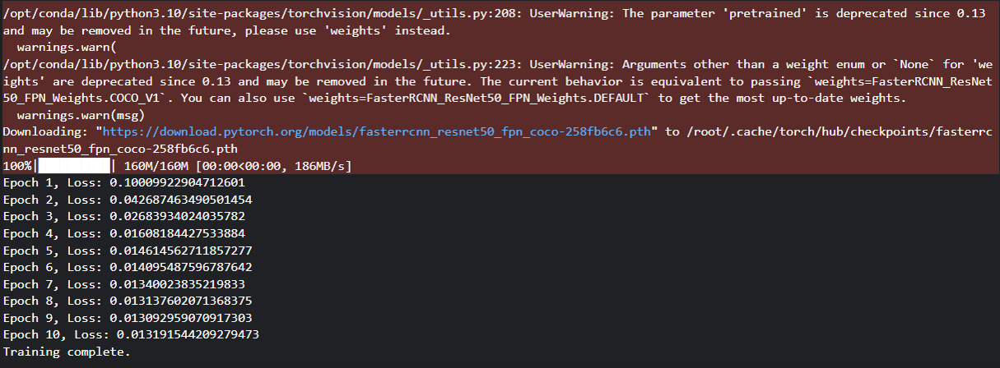

# Model Evaluation

> * Model Load

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

In [ ]:
# Initialize the model with the number of classes (including background class)
num_classes = 3  # 2 classes + background
faster_rcnn = get_model(num_classes)

# Load the local model weights with appropriate mapping for CPU or GPU
model_path = '/content/drive/MyDrive/Drowse_Pro/src/fine_tuned_faster_rcnn.pth'

# Load the model to the appropriate device
faster_rcnn.load_state_dict(torch.load(model_path, map_location=device))

# Set the model to evaluation mode
faster_rcnn.eval()

# Move the model to GPU if available
faster_rcnn.to(device)



/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth
100%|██████████| 160M/160M [00:01<00:00, 93.9MB/s]


FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

> * Data Loader

In [ ]:
def custom_collate_fn(batch):
    return tuple(zip(*batch))

# Paths to the dataset
root_test = '/content/drive/MyDrive/Drowse_Pro/coco_splits/test_split'  # Path to the folder containing images
annotation = '/content/drive/MyDrive/Drowse_Pro/coco_splits/test_split/_annotations.coco.json'  # Path to the COCO annotation file

# Define your dataset and dataloader
dataset = COCODataset(root=root_test, annotation=annotation, transforms=get_transform())
test_dataloader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=4, collate_fn=custom_collate_fn)


loading annotations into memory...
Done (t=2.45s)
creating index...
index created!


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


> * Confusin matrix

/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()


Length of y_true: 400, Length of y_pred: 400


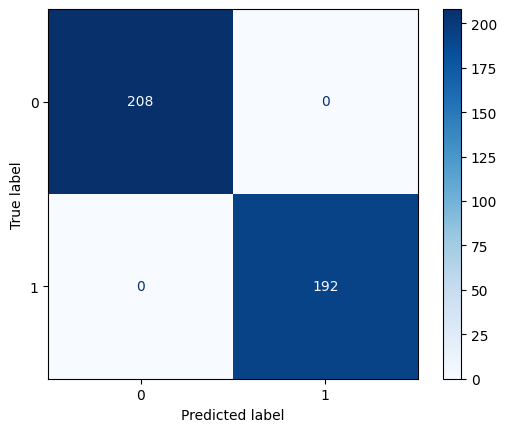

In [ ]:
# Set the model to evaluation mode
faster_rcnn.eval()

# Initialize lists to store true labels and predicted labels
y_true = []
y_pred = []

# Loop over the test data to get predictions
with torch.no_grad():
    for images, targets in test_dataloader:
        # Move images to the device (GPU or CPU)
        images = [image.to(device) for image in images]

        # Get the predictions from the model
        outputs = faster_rcnn(images)

        # Loop through each image and extract the predictions and true labels
        for i, output in enumerate(outputs):
            preds = output['labels'].cpu().numpy()  # Predicted labels by the model

            # Access true labels - assuming targets[i] is a dictionary with 'labels' or similar key
            if isinstance(targets[i], dict):
                true = targets[i]['labels'].cpu().numpy()  # Modify this line as needed based on the structure
            else:
                true = [obj['category_id'] for obj in targets[i]]  # COCO-style annotation

            # Ensure the lengths match - Adjust predictions and true labels
            min_len = min(len(preds), len(true))  # Take only the matched number of labels
            y_pred.extend(preds[:min_len])
            y_true.extend(true[:min_len])

# Check the lengths of y_true and y_pred
print(f"Length of y_true: {len(y_true)}, Length of y_pred: {len(y_pred)}")

# Generate confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.show()

> * F1-Curve

In [ ]:
# Function to evaluate the model and collect predictions and ground truths
def evaluate_model(model, dataloader, device):
    model.eval()  # Set the model to evaluation mode
    all_preds = []
    all_labels = []

    with torch.no_grad():  # No need for gradient computation during evaluation
        for images, targets in dataloader:
            images = [img.to(device) for img in images]
            outputs = model(images)

            # Collect ground truth and predictions for F1 curve calculation
            for i, output in enumerate(outputs):
                # Get predicted boxes and scores
                pred_boxes = output['boxes'].cpu().numpy()
                pred_scores = output['scores'].cpu().numpy()
                pred_labels = output['labels'].cpu().numpy()

                # Get true boxes and labels
                true_boxes = targets[i]['boxes'].cpu().numpy()
                true_labels = targets[i]['labels'].cpu().numpy()

                all_preds.append((pred_boxes, pred_scores, pred_labels))
                all_labels.append((true_boxes, true_labels))

    return all_preds, all_labels

# Function to compute precision, recall, and F1-score
def compute_f1_curve(all_preds, all_labels, num_classes=2):
    # Initialize arrays to store precision, recall, and f1 scores for each threshold
    f1_scores = []
    thresholds = np.linspace(0, 1, 100)  # Define thresholds from 0 to 1

    for threshold in thresholds:
        # Initialize lists to store true positives, false positives, false negatives
        all_true_positives = 0
        all_false_positives = 0
        all_false_negatives = 0

        for preds, labels in zip(all_preds, all_labels):
            pred_boxes, pred_scores, pred_labels = preds
            true_boxes, true_labels = labels

            # Filter predictions by threshold
            filtered_pred_labels = pred_labels[pred_scores >= threshold]

            # Count true positives, false positives, and false negatives
            true_positives = np.sum(filtered_pred_labels == true_labels)
            false_positives = np.sum(filtered_pred_labels != true_labels)
            false_negatives = np.sum(true_labels != filtered_pred_labels)

            all_true_positives += true_positives
            all_false_positives += false_positives
            all_false_negatives += false_negatives

        # Compute precision, recall, and F1 score
        precision = all_true_positives / (all_true_positives + all_false_positives + 1e-7)
        recall = all_true_positives / (all_true_positives + all_false_negatives + 1e-7)
        f1 = 2 * (precision * recall) / (precision + recall + 1e-7)
        f1_scores.append(f1)

    return thresholds, f1_scores

# Function to plot the F1-curve
def plot_f1_curve(thresholds, f1_scores):
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds, f1_scores, label='F1-Score')
    plt.xlabel('Threshold')
    plt.ylabel('F1-Score')
    plt.title('F1-Score vs Threshold Curve')
    plt.grid(True)
    plt.legend()
    plt.show()

# Run evaluation to get predictions and ground truth
all_preds, all_labels = evaluate_model(faster_rcnn, test_dataloader, device)

# Compute F1 curve
thresholds, f1_scores = compute_f1_curve(all_preds, all_labels)

# Plot the F1-curve
plot_f1_curve(thresholds, f1_scores)

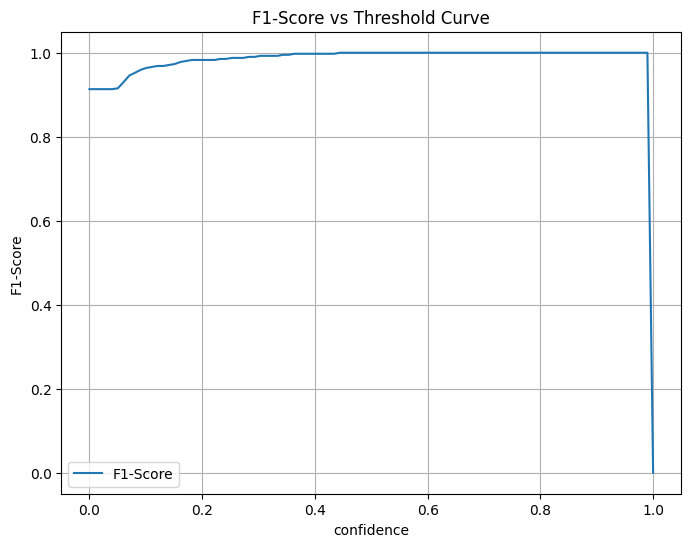



# Model Test

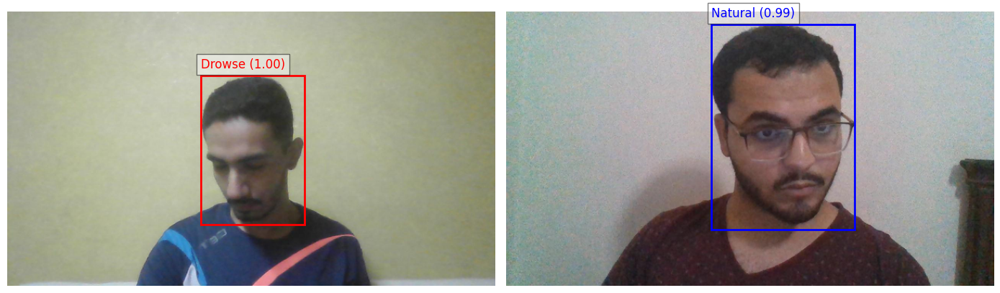

In [ ]:
url6 = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_01_02_04_Pro_jpg.rf.e95fc35297148664ddaad06e53dfcf9d.jpg'
url7 = '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_00_46_12_Pro_jpg.rf.de7df2dd23f08e9544a1ca42b9e5f84f.jpg'

plot_two_images_f_rcnn(url6,url7,faster_rcnn)


#  Grad Cam Custom Code

In [ ]:
class GradCam:
    def __init__(self, model, target_layer):
        self.model = model
        self.target_layer = target_layer
        self.gradients = None

        # Hook for gradients
        self.target_layer.register_forward_hook(self.forward_hook)
        self.target_layer.register_full_backward_hook(self.backward_hook)  # For backward compatibility

    def forward_hook(self, module, input, output):
        self.output = output

    def backward_hook(self, module, grad_in, grad_out):
        self.gradients = grad_out[0]

    def __call__(self, input_image, class_idx=None):
        input_image = input_image.unsqueeze(0)  # Add batch dimension

        # Forward pass
        outputs = self.model(input_image)
        if class_idx is None:
            class_idx = torch.argmax(outputs[0]['scores'])  # Use highest scored prediction

        # Get the score for the selected class
        score = outputs[0]['scores'][class_idx]
        self.model.zero_grad()
        score.backward(retain_graph=True)

        # Generate Grad-CAM heatmap
        cam = self.compute_cam()
        return cam

    def compute_cam(self):
        # Pool the gradients across the width and height
        pooled_gradients = torch.mean(self.gradients, dim=[0, 2, 3])

        # Weight the channels by corresponding gradients
        for i in range(self.output.size(1)):
            self.output[:, i, :, :] *= pooled_gradients[i]

        # Average the channels of the output
        cam = torch.mean(self.output, dim=1).squeeze()

        # Apply ReLU to keep only positive values
        cam = torch.relu(cam)

        # Normalize the cam heatmap
        cam -= cam.min()
        cam /= cam.max()
        return cam.cpu().detach().numpy()

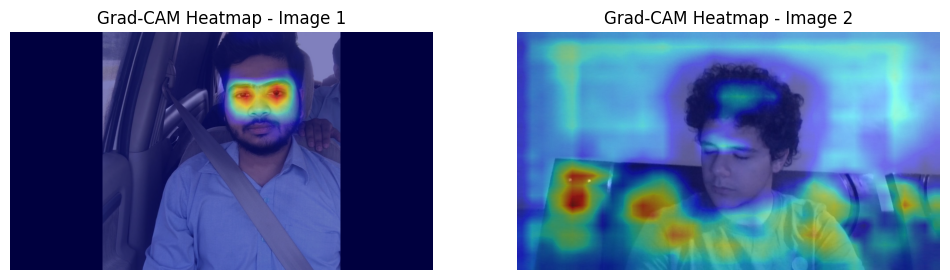

In [ ]:
# Access the actual target layer from the model
target_layer = faster_rcnn.backbone.body.layer4

# Initialize Grad-CAM
grad_cam = GradCam(faster_rcnn, target_layer)

# Apply Grad-CAM for two images in the batch
for images, targets in test_dataloader:
    # Get two images from the batch
    image1 = images[0].to(device)
    image2 = images[1].to(device)

    # Enable gradient calculation for the forward pass
    with torch.enable_grad():
        # Get the Grad-CAM for both images
        cam1 = grad_cam(image1)
        cam2 = grad_cam(image2)

    # Rescale CAM to match the image size
    cam1 = cv2.resize(cam1, (image1.shape[2], image1.shape[1]))
    cam2 = cv2.resize(cam2, (image2.shape[2], image2.shape[1]))

    # Plot both Grad-CAM heatmaps side by side
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))

    axs[0].imshow(image1.permute(1, 2, 0).cpu().numpy())  # Original image 1
    axs[0].imshow(cam1, cmap='jet', alpha=0.5)  # Grad-CAM overlay 1
    axs[0].set_title('Grad-CAM Heatmap - Image 1')
    axs[0].axis('off')

    axs[1].imshow(image2.permute(1, 2, 0).cpu().numpy())  # Original image 2
    axs[1].imshow(cam2, cmap='jet', alpha=0.5)  # Grad-CAM overlay 2
    axs[1].set_title('Grad-CAM Heatmap - Image 2')
    axs[1].axis('off')

    plt.show()

    break  # Stop after the first batch for demonstration

# What about Night Data

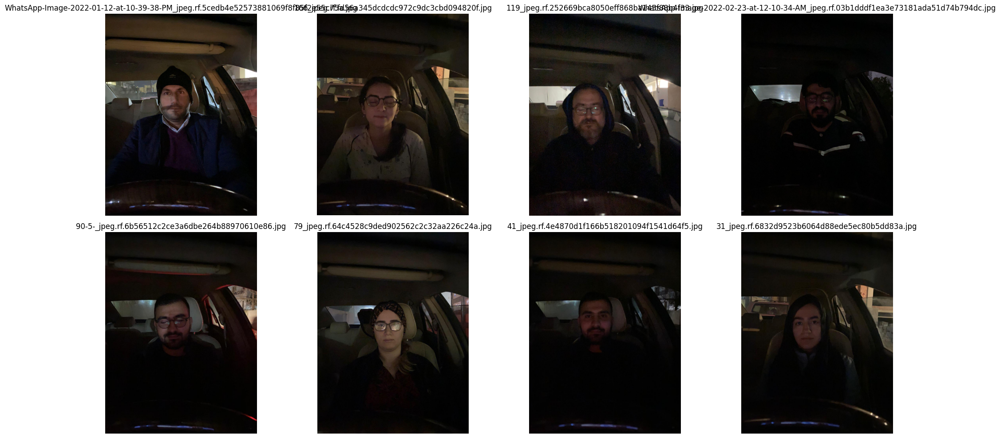

In [ ]:
folder_path = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/train/images'
num_of_images = 8
seed = 42
plot_images_from_folder(folder_path,num_of_images,seed)

# Test on Night data

* # YOLO


0: 640x480 (no detections), 64.2ms
Speed: 70.3ms preprocess, 64.2ms inference, 1.3ms postprocess per image at shape (1, 3, 640, 480)

0: 640x480 (no detections), 12.1ms
Speed: 3.9ms preprocess, 12.1ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 480)


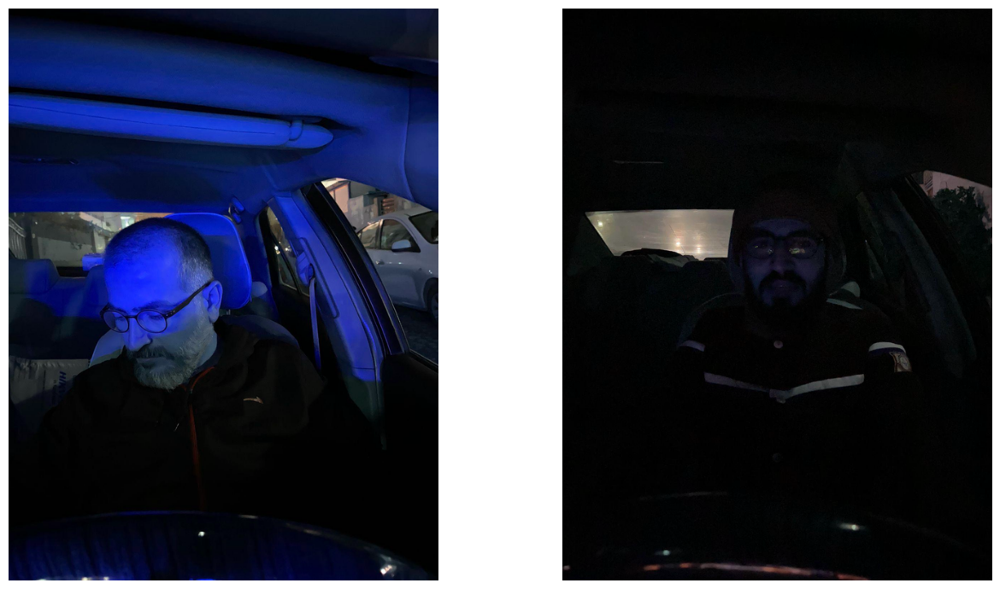

In [ ]:
url8 = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/train/WhatsApp-Image-2021-12-19-at-11-41-51-AM_jpeg.rf.6ba17e0ae34cc0292d34344b29a24933.jpg'
url9 = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/train/WhatsApp-Image-2022-02-23-at-12-11-06-AM_jpeg.rf.85391e4ac3ac34924e5d25746dd065d5.jpg'

plot_two_images(url8,url9,model_aug)

* #  Faster RCNN

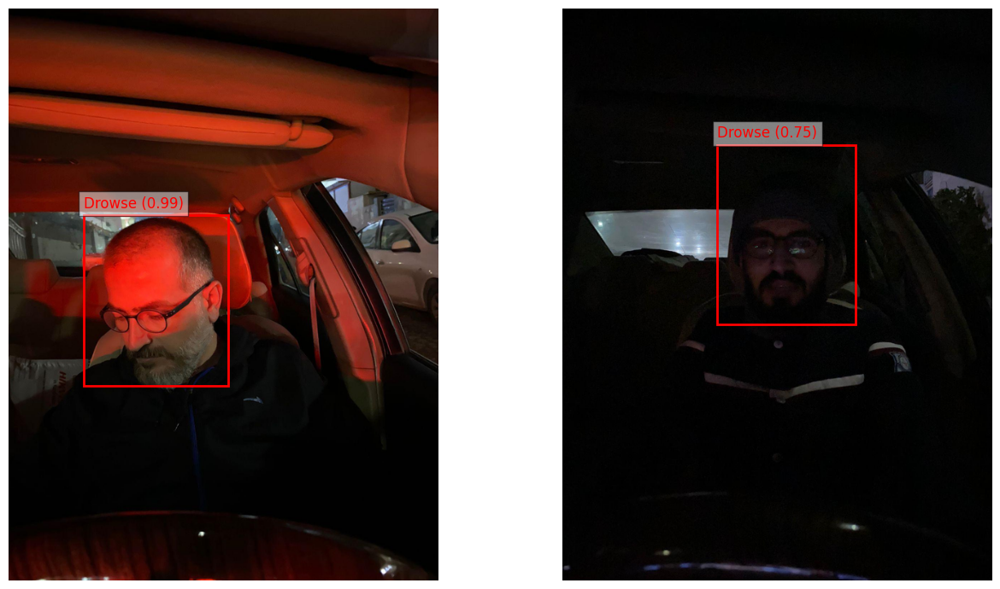

In [ ]:
plot_two_images_f_rcnn(url8,url9,faster_rcnn)

# **problem statement 2** :
* # YOLO : the current Model can't detect the the person state
* # faster : the current Model detect but with some confusion

# train with Night Data

In [ ]:
results = model_aug.train(
   data='/content/drive/MyDrive/Drowse_Pro/night_data/night_data/data.yaml',
   epochs=32,
   batch=16,
   name='yolov8s_night',
   )

Ultralytics YOLOv8.2.100 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=/content/drive/MyDrive/Drowse_Pro/src/yolov8s_aug/weights/best.pt, data=/content/drive/MyDrive/Drowse_Pro/night_data/night_data/data.yaml, epochs=32, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8s_night, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_

100%|██████████| 755k/755k [00:00<00:00, 25.0MB/s]



                   from  n    params  module                                       arguments                     
  0                  -1  1       928  ultralytics.nn.modules.conv.Conv             [3, 32, 3, 2]                 
  1                  -1  1     18560  ultralytics.nn.modules.conv.Conv             [32, 64, 3, 2]                
  2                  -1  1     29056  ultralytics.nn.modules.block.C2f             [64, 64, 1, True]             
  3                  -1  1     73984  ultralytics.nn.modules.conv.Conv             [64, 128, 3, 2]               
  4                  -1  2    197632  ultralytics.nn.modules.block.C2f             [128, 128, 2, True]           
  5                  -1  1    295424  ultralytics.nn.modules.conv.Conv             [128, 256, 3, 2]              
  6                  -1  2    788480  ultralytics.nn.modules.block.C2f             [256, 256, 2, True]           
  7                  -1  1   1180672  ultralytics.nn.modules.conv.Conv             [256

100%|██████████| 6.25M/6.25M [00:00<00:00, 104MB/s]


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/Drowse_Pro/night_data/night_data/labels/train... 386 images, 0 backgrounds, 0 corrupt: 100%|██████████| 386/386 [03:00<00:00,  2.14it/s]


train: New cache created: /content/drive/MyDrive/Drowse_Pro/night_data/night_data/labels/train.cache
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/local/lib/python3.10/dist-packages/albumentations/__init__.py:13: UserWarning: A new version of Albumentations is available: 1.4.16 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/MyDrive/Drowse_Pro/night_data/night_data/labels/test... 96 images, 0 backgrounds, 0 corrupt: 100%|██████████| 96/96 [01:35<00:00,  1.00it/s]

val: New cache created: /content/drive/MyDrive/Drowse_Pro/night_data/night_data/labels/test.cache


Plotting labels to runs/detect/yolov8s_night/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001667, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 2 dataloader workers
Logging results to runs/detect/yolov8s_night
Starting training for 32 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/32      4.14G      1.825      2.771      1.776          2        640: 100%|██████████| 25/25 [00:13<00:00,  1.91it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:03<00:00,  1.09s/it]

                   all         96         96      0.723      0.281      0.389      0.261



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/32      4.09G     0.9337       1.12      1.121          3        640: 100%|██████████| 25/25 [00:10<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.97it/s]

                   all         96         96      0.816      0.747      0.813       0.64



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/32      4.12G     0.7346     0.8199      1.007          2        640: 100%|██████████| 25/25 [00:12<00:00,  1.96it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.25it/s]

                   all         96         96      0.937      0.885       0.94      0.765



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/32       4.1G     0.7477     0.7458      1.018          3        640: 100%|██████████| 25/25 [00:11<00:00,  2.19it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.36it/s]

                   all         96         96      0.945      0.887      0.943      0.809



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/32      4.09G     0.7358     0.7118      1.031          4        640: 100%|██████████| 25/25 [00:09<00:00,  2.68it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.82it/s]

                   all         96         96      0.967       0.96      0.978      0.831



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/32      4.12G     0.6676     0.6309     0.9873          5        640: 100%|██████████| 25/25 [00:09<00:00,  2.64it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.98it/s]

                   all         96         96      0.963      0.926      0.977      0.834



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/32      4.11G     0.6825     0.5971     0.9902          2        640: 100%|██████████| 25/25 [00:12<00:00,  1.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.04it/s]

                   all         96         96      0.959      0.967       0.99      0.847



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/32      3.95G     0.6361     0.5454     0.9525          2        640: 100%|██████████| 25/25 [00:12<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.24it/s]

                   all         96         96       0.93      0.991      0.994      0.871



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/32      4.09G     0.6307     0.5706      0.965          2        640: 100%|██████████| 25/25 [00:09<00:00,  2.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.22it/s]

                   all         96         96      0.957      0.986      0.993      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/32      3.96G     0.6441     0.5542     0.9654          5        640: 100%|██████████| 25/25 [00:09<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.58it/s]

                   all         96         96      0.979      0.943      0.985      0.848



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/32      4.13G     0.6388     0.5214     0.9698          3        640: 100%|██████████| 25/25 [00:11<00:00,  2.10it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.46it/s]

                   all         96         96      0.916      0.961      0.992      0.867



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/32      4.11G     0.5837     0.5069     0.9434          3        640: 100%|██████████| 25/25 [00:11<00:00,  2.09it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]

                   all         96         96      0.972       0.97      0.987      0.859



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/32      3.91G     0.5835     0.4943       0.94          3        640: 100%|██████████| 25/25 [00:09<00:00,  2.60it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.50it/s]

                   all         96         96      0.957      0.978      0.993      0.857



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/32      3.96G     0.6078     0.5145     0.9452          5        640: 100%|██████████| 25/25 [00:10<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.45it/s]

                   all         96         96      0.967      0.972      0.992       0.86



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/32      4.11G     0.6027     0.4702     0.9491          5        640: 100%|██████████| 25/25 [00:12<00:00,  2.04it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.07it/s]

                   all         96         96      0.986      0.983      0.993      0.869



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/32      3.95G     0.5713     0.4443     0.9367          6        640: 100%|██████████| 25/25 [00:11<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.52it/s]

                   all         96         96      0.994      0.971      0.995      0.864



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/32      4.09G     0.5631     0.4253     0.9378          2        640: 100%|██████████| 25/25 [00:08<00:00,  2.82it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.57it/s]

                   all         96         96      0.966      0.981      0.995      0.871



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/32      4.12G     0.5472     0.4112     0.9315          3        640: 100%|██████████| 25/25 [00:10<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.32it/s]

                   all         96         96      0.977      0.979      0.995       0.88



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/32      4.13G     0.5546     0.4409     0.9322          5        640: 100%|██████████| 25/25 [00:12<00:00,  1.98it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.48it/s]

                   all         96         96      0.968      0.968      0.993      0.882



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/32      3.95G     0.5556     0.4946     0.9406          2        640: 100%|██████████| 25/25 [00:11<00:00,  2.21it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.23it/s]

                   all         96         96      0.998      0.999      0.995      0.866



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/32      4.07G     0.5344     0.4276     0.9302          6        640: 100%|██████████| 25/25 [00:08<00:00,  2.81it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.31it/s]

                   all         96         96      0.947      0.977      0.995      0.895



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/32      3.96G     0.5242     0.3934     0.9287          4        640: 100%|██████████| 25/25 [00:10<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]

                   all         96         96      0.992      0.996      0.995      0.885


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/32      4.11G     0.4657      0.301     0.8582          2        640: 100%|██████████| 25/25 [00:14<00:00,  1.70it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         96         96       0.99          1      0.995      0.882



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/32      3.95G     0.4528     0.2735     0.8635          2        640: 100%|██████████| 25/25 [00:12<00:00,  2.03it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.19it/s]

                   all         96         96      0.963      0.964      0.995      0.874



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/32      4.25G     0.4844     0.2961     0.8572          2        640: 100%|██████████| 25/25 [00:09<00:00,  2.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.74it/s]

                   all         96         96      0.985      0.979      0.994      0.886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/32      4.12G     0.4566     0.2778     0.8517          2        640: 100%|██████████| 25/25 [00:09<00:00,  2.65it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.01it/s]

                   all         96         96          1      0.976      0.994      0.894



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/32      4.12G     0.4427     0.2658     0.8484          2        640: 100%|██████████| 25/25 [00:12<00:00,  2.07it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.51it/s]

                   all         96         96       0.99      0.998      0.995      0.899



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/32      3.95G      0.441     0.3288     0.8601          2        640: 100%|██████████| 25/25 [00:10<00:00,  2.28it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.59it/s]

                   all         96         96      0.978      0.988      0.994      0.891



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/32      4.09G     0.4381     0.2537     0.8479          2        640: 100%|██████████| 25/25 [00:08<00:00,  2.97it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  1.51it/s]

                   all         96         96      0.965          1      0.995       0.89



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/32      3.96G     0.4234     0.2558     0.8319          2        640: 100%|██████████| 25/25 [00:09<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.13it/s]

                   all         96         96      0.971      0.999      0.995      0.893



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/32      4.12G     0.4228     0.2407       0.83          2        640: 100%|██████████| 25/25 [00:12<00:00,  2.08it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:01<00:00,  2.35it/s]

                   all         96         96      0.995      0.994      0.995      0.897



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/32      3.95G     0.4291     0.2468     0.8476          2        640: 100%|██████████| 25/25 [00:10<00:00,  2.31it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.08it/s]

                   all         96         96      0.986      0.999      0.995        0.9



32 epochs completed in 0.129 hours.
Optimizer stripped from runs/detect/yolov8s_night/weights/last.pt, 22.5MB
Optimizer stripped from runs/detect/yolov8s_night/weights/best.pt, 22.5MB

Validating runs/detect/yolov8s_night/weights/best.pt...
Ultralytics YOLOv8.2.100 🚀 Python-3.10.12 torch-2.4.1+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11,126,358 parameters, 0 gradients, 28.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 3/3 [00:02<00:00,  1.46it/s]


                   all         96         96      0.986      0.999      0.995        0.9
                Drowse         47         47          1      0.998      0.995       0.91
               Natural         49         49      0.972          1      0.995      0.891
Speed: 0.2ms preprocess, 3.3ms inference, 0.0ms loss, 4.3ms postprocess per image
Results saved to runs/detect/yolov8s_night


In [ ]:
performance3 = pd.read_csv('/content/drive/MyDrive/Drowse_Pro/src/yolov8s_night/results.csv')
performance3[25:31]

,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
25,26,0.45658,0.27780,0.85171,1.00000,0.97611,0.99439,0.89352,0.49786,0.28482,0.86557,0.000378,0.000378,0.000378
26,27,0.44269,0.26577,0.84840,0.98998,0.99776,0.99460,0.89899,0.48723,0.25931,0.85825,0.000326,0.000326,0.000326
27,28,0.44102,0.32878,0.86010,0.97806,0.98838,0.99418,0.89124,0.49237,0.26758,0.85517,0.000275,0.000275,0.000275
28,29,0.43815,0.25369,0.84786,0.96518,1.00000,0.99480,0.89010,0.48913,0.26386,0.85279,0.000223,0.000223,0.000223
29,30,0.42343,0.25576,0.83185,0.97148,0.99865,0.99500,0.89315,0.47854,0.24509,0.85257,0.000171,0.000171,0.000171
30,31,0.42283,0.24070,0.82997,0.99541,0.99396,0.99500,0.89709,0.47977,0.23390,0.85659,0.000120,0.000120,0.000120


* **copy to drive**

In [ ]:
# !cp -r /content/runs/detect/yolov8s_night /content/drive/MyDrive/Drowse_Pro/src

# Model Evaluation

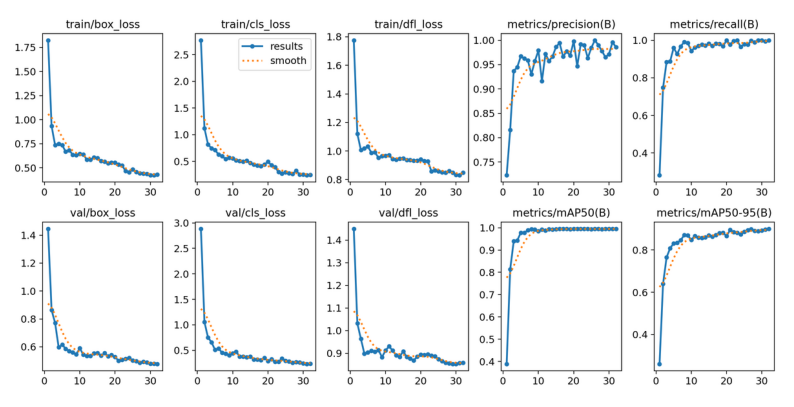

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_night/results.png"
plot_one_image(url)

# 1. Confusion matrix

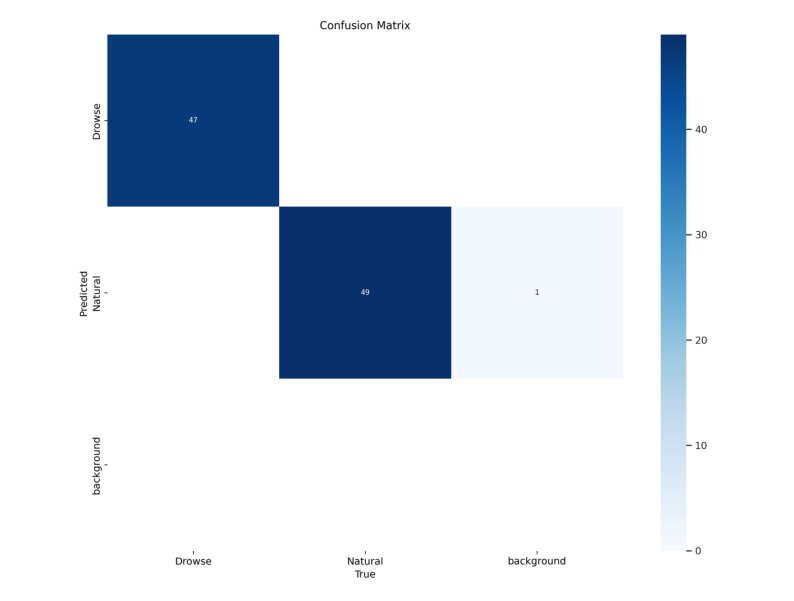

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_night/confusion_matrix.png"
plot_one_image(url)

# 2. F1 Curve

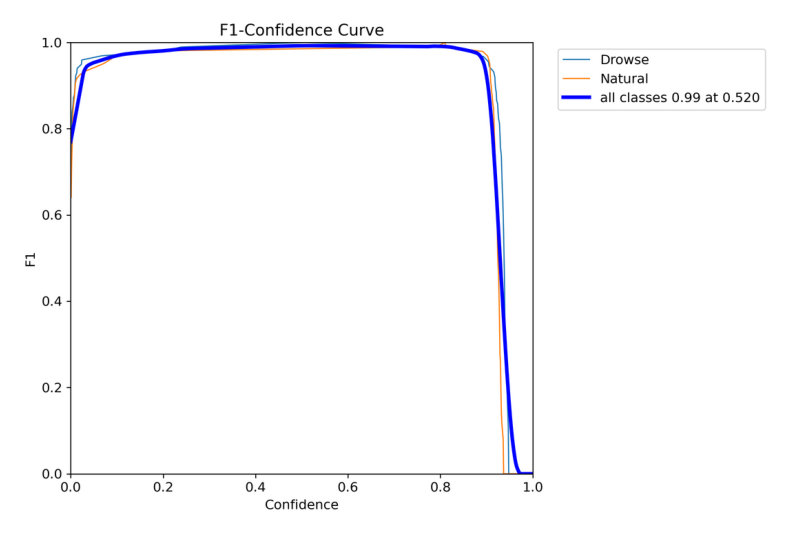

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_night/F1_curve.png"
plot_one_image(url)

# Model Load

In [ ]:
night_model = YOLO('/content/drive/MyDrive/Drowse_Pro/src/yolov8s_night/weights/best.pt')

# let's test Now


0: 640x480 1 Drowse, 131.7ms
Speed: 3.6ms preprocess, 131.7ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 480)

0: 640x480 1 Natural, 22.9ms
Speed: 10.4ms preprocess, 22.9ms inference, 2.0ms postprocess per image at shape (1, 3, 640, 480)


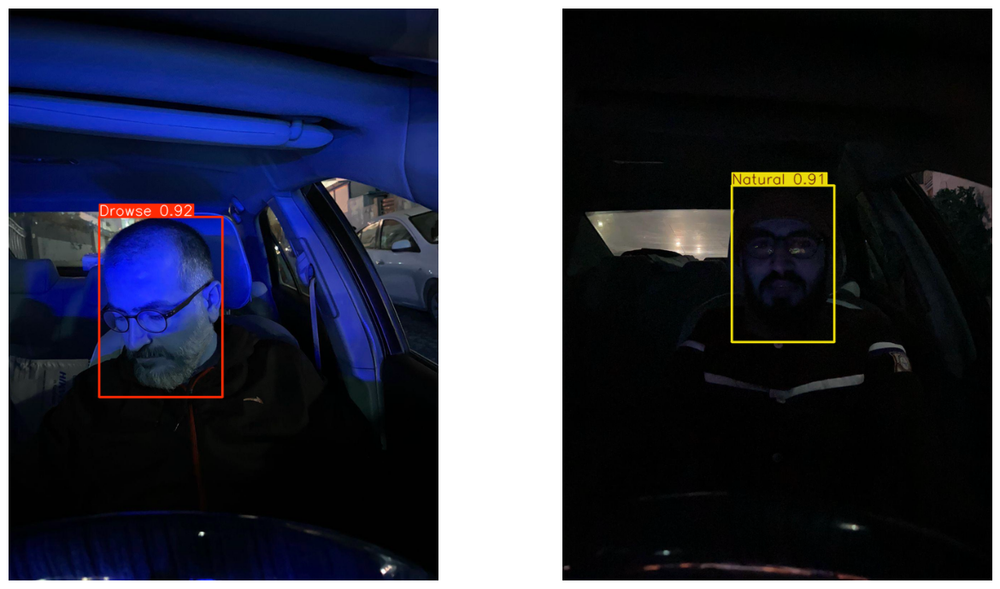

In [ ]:
plot_two_images(url8,url9,night_model)

# Grad cam

In [ ]:
target_layer = night_model.model.model[22].cv3[2] # This accesses the last convolutional layer in the third detection head.

In [ ]:
img = cv2.imread('/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/train/WhatsApp-Image-2021-12-19-at-11-41-51-AM_jpeg.rf.6ba17e0ae34cc0292d34344b29a24933.jpg')
img = cv2.resize(img, (640, 640))
rgb_img = img.copy()
img = np.float32(img) / 255


img2 = cv2.imread('/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/train/WhatsApp-Image-2022-02-23-at-12-11-06-AM_jpeg.rf.85391e4ac3ac34924e5d25746dd065d5.jpg')
img2 = cv2.resize(img2, (640, 640))
rgb_img2 = img2.copy()
img2 = np.float32(img2) / 255


0: 640x640 1 Drowse, 17.7ms
Speed: 2.3ms preprocess, 17.7ms inference, 2.1ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Natural, 18.1ms
Speed: 2.1ms preprocess, 18.1ms inference, 1.7ms postprocess per image at shape (1, 3, 640, 640)


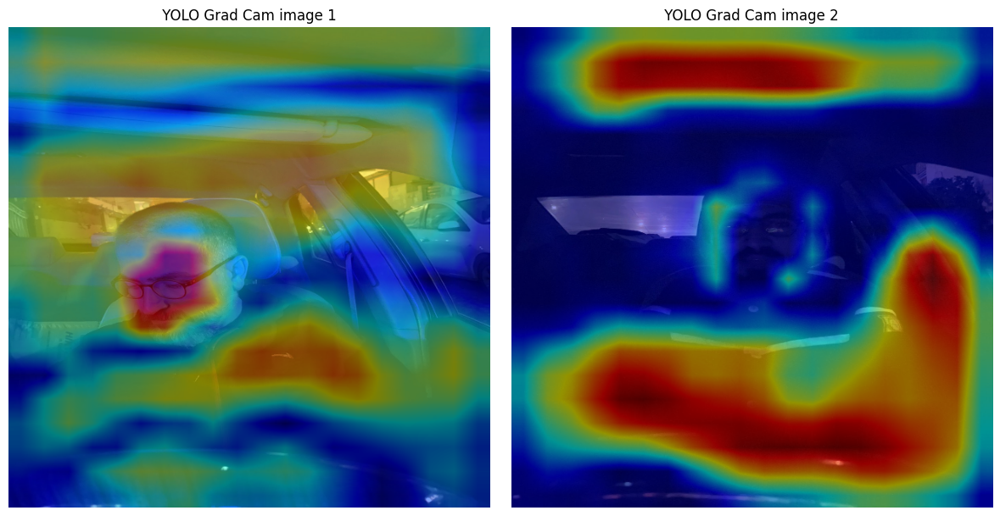

In [ ]:

# Display the images side by side using subplots
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# First CAM image
cam = EigenCAM(night_model, target_layer, task='od')
grayscale_cam = cam(rgb_img)[0, :, :]
cam_image = show_cam_on_image(img, grayscale_cam, use_rgb=True)

ax[0].imshow(cam_image)
ax[0].set_title(" YOLO Grad Cam image 1 ")
ax[0].axis('off')

# Second CAM image
cam2 = EigenCAM(night_model, target_layer, task='od')
grayscale_cam2 = cam2(rgb_img2)[0, :, :]
cam_image2 = show_cam_on_image(img2, grayscale_cam2, use_rgb=True)

ax[1].imshow(cam_image2)
ax[1].set_title(" YOLO Grad Cam image 2 ")
ax[1].axis('off')

# Display the images side by side
plt.tight_layout()
plt.show()

# let's test with a collection of different samples


0: 384x640 1 Natural, 13.0ms
Speed: 2.4ms preprocess, 13.0ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Natural, 11.5ms
Speed: 1.9ms preprocess, 11.5ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Drowse, 11.6ms
Speed: 1.8ms preprocess, 11.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Natural, 11.8ms
Speed: 1.1ms preprocess, 11.8ms inference, 1.6ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Drowse, 11.7ms
Speed: 1.4ms preprocess, 11.7ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Natural, 11.5ms
Speed: 1.4ms preprocess, 11.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 640x480 1 Natural, 13.4ms
Speed: 2.0ms preprocess, 13.4ms inference, 1.2ms postprocess per image at shape (1, 3, 640, 480)

0: 640x480 1 Drowse, 12.9ms
Speed: 2.1ms preprocess, 12.9ms inference, 1.2ms postprocess per image at shape (1, 

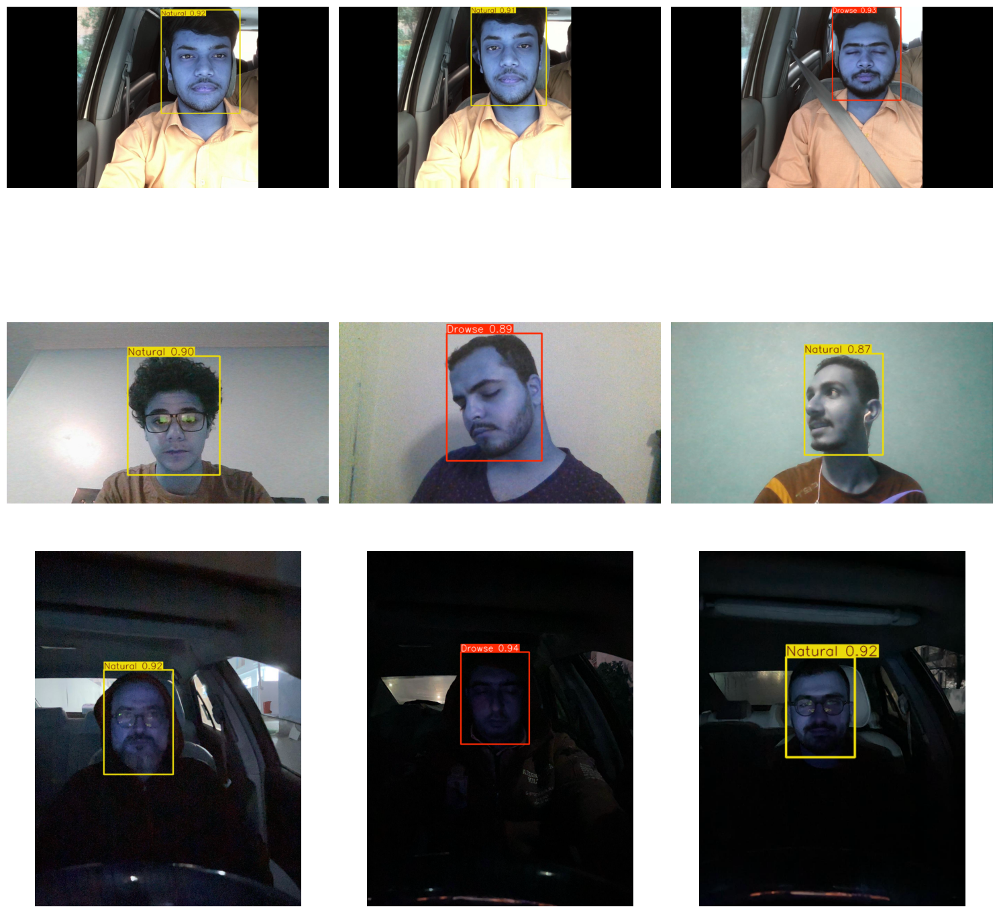

In [ ]:
images_paths = ['/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/63_jpg.rf.e7fe68dd2adff5d1f93b9a695d8e157b.jpg',
                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/aug_710_10_jpg.rf.f31e7196b06b7d98ea1fa398e60acb77.jpg',
                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/1730_jpg.rf.8e241bff0cef755cf00ddd4005f54588.jpg',

                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240913_23_40_57_Pro_jpg.rf.00812386eb3fea3d9b7487d01a270d7d.jpg',
                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_00_50_57_Pro_jpg.rf.b8afa0c0f4b9df6e0ec58fa6eab71710.jpg',
                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_00_55_00_Pro_jpg.rf.1d0c4439f1766ad8883843fe77e17b20.jpg',

                '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/test/96_jpeg.rf.1308590dd11459129aad9ef2fec708d0.jpg',
                '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/test/WhatsApp-Image-2022-02-23-at-12-12-41-AM-1-_jpeg.rf.c426d7a945b1dba0f76e34f3ec473bed.jpg',
                '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/test/90-1-_jpeg.rf.add6d08e8ac485a9c539af75ea98d633.jpg']



plot_images(images_paths,night_model)

> #  Faster RCNN

# Faster RCNN training on **Night Data**

In [ ]:
# # Paths to the dataset
# root = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data_coco/night_data_coco/train'  # Path to the folder containing images
# annotation = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data_coco/night_data_coco/train/_annotations.coco.json'  # Path to the COCO annotation file

# # Create the dataset
# dataset = COCODataset(root=root, annotation=annotation, transforms=get_transform())

# # DataLoader to handle batching and shuffling
# data_loader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=4, collate_fn=lambda x: tuple(zip(*x)))

# # Define the model
# #num_classes = 3  # 2 classes (Drowse, Natural) + 1 for background
# #model = get_model(num_classes)

# # Move model to the right device
# device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
# faster_rcnn.to(device)

# # Define optimizer and learning rate
# params = [p for p in faster_rcnn.parameters() if p.requires_grad]
# optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, weight_decay=0.0005)

# # Learning rate scheduler
# lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, gamma=0.1)

# # Training loop
# num_epochs = 10
# for epoch in range(num_epochs):
#     faster_rcnn.train()
#     running_loss = 0.0
#     for images, targets in data_loader:
#         images = list(img.to(device) for img in images)
#         targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

#         optimizer.zero_grad()
#         loss_dict = faster_rcnn(images, targets)
#         losses = sum(loss for loss in loss_dict.values())
#         losses.backward()
#         optimizer.step()

#         running_loss += losses.item()

#     print(f"Epoch {epoch + 1}, Loss: {running_loss / len(data_loader)}")

#     # Update the learning rate
#     lr_scheduler.step()

# print("Training complete.")

loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


Epoch 1, Loss: 0.04803637816503491
Epoch 2, Loss: 0.03169627881311264
Epoch 3, Loss: 0.027452855678179216
Epoch 4, Loss: 0.019273931381398254
Epoch 5, Loss: 0.018172442404188447
Epoch 6, Loss: 0.01771077536737796
Epoch 7, Loss: 0.017315959860330698
Epoch 8, Loss: 0.017202085296901846
Epoch 9, Loss: 0.01725535504711965
Epoch 10, Loss: 0.01693030985398698
Training complete.


In [ ]:
# Save the fine-tuned model
torch.save(faster_rcnn.state_dict(), '/content/drive/MyDrive/Drowse_Pro/src/faster_Rcnn_night.pth')

# Model Upload

In [ ]:
# Set up the device
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

In [ ]:
# Initialize the model with the number of classes (including background class)
num_classes = 3  # 2 classes + background
faster_rcnn_night = get_model(num_classes)

# Load the local model weights with appropriate mapping for CPU or GPU
model_path = '/content/drive/MyDrive/Drowse_Pro/src/faster_Rcnn_night.pth'

# Load the model to the appropriate device
faster_rcnn_night.load_state_dict(torch.load(model_path, map_location=device))

# Set the model to evaluation mode
faster_rcnn_night.eval()

# Move the model to GPU if available
faster_rcnn_night.to(device)

FasterRCNN(
  (transform): GeneralizedRCNNTransform(
      Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
      Resize(min_size=(800,), max_size=1333, mode='bilinear')
  )
  (backbone): BackboneWithFPN(
    (body): IntermediateLayerGetter(
      (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): FrozenBatchNorm2d(64, eps=0.0)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): FrozenBatchNorm2d(64, eps=0.0)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): FrozenBatchNorm2d(64, eps=0.0)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): FrozenBatchNorm2d(256, eps=0.0)
          (relu): ReLU(

# test data loader

In [ ]:
def custom_collate_fn(batch):
    return tuple(zip(*batch))

# Paths to the dataset
root_test = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data_coco/night_data_coco/test'  # Path to the folder containing images
annotation = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data_coco/night_data_coco/test/_annotations.coco.json'  # Path to the COCO annotation file

# Define your dataset and dataloader
dataset = COCODataset(root=root_test, annotation=annotation, transforms=get_transform())
test_dataloader = DataLoader(dataset, batch_size=4, shuffle=True, num_workers=4, collate_fn=custom_collate_fn)


loading annotations into memory...
Done (t=0.01s)
creating index...
index created!


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


# Model Evaluation

* #  confusion matrix

Length of y_true: 96, Length of y_pred: 96


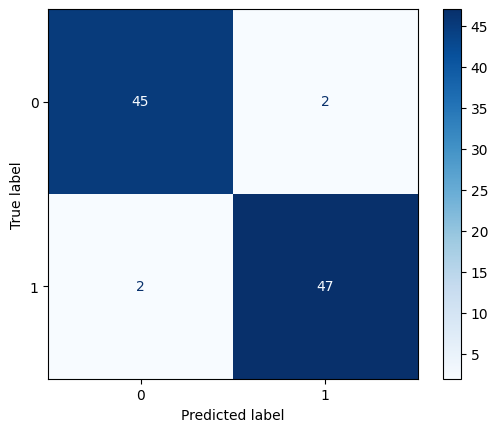

In [ ]:
# Set the model to evaluation mode
faster_rcnn_night.eval()

# Initialize lists to store true labels and predicted labels
y_true = []
y_pred = []

# Loop over the test data to get predictions
with torch.no_grad():
    for images, targets in test_dataloader:
        # Move images to the device (GPU or CPU)
        images = [image.to(device) for image in images]

        # Get the predictions from the model
        outputs = faster_rcnn_night(images)

        # Loop through each image and extract the predictions and true labels
        for i, output in enumerate(outputs):
            preds = output['labels'].cpu().numpy()  # Predicted labels by the model

            # Access true labels - assuming targets[i] is a dictionary with 'labels' or similar key
            if isinstance(targets[i], dict):
                true = targets[i]['labels'].cpu().numpy()  # Modify this line as needed based on the structure
            else:
                true = [obj['category_id'] for obj in targets[i]]  # COCO-style annotation

            # Ensure the lengths match - Adjust predictions and true labels
            min_len = min(len(preds), len(true))  # Take only the matched number of labels
            y_pred.extend(preds[:min_len])
            y_true.extend(true[:min_len])

# Check the lengths of y_true and y_pred
print(f"Length of y_true: {len(y_true)}, Length of y_pred: {len(y_pred)}")

# Generate confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.show()

* # F1 Curve

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


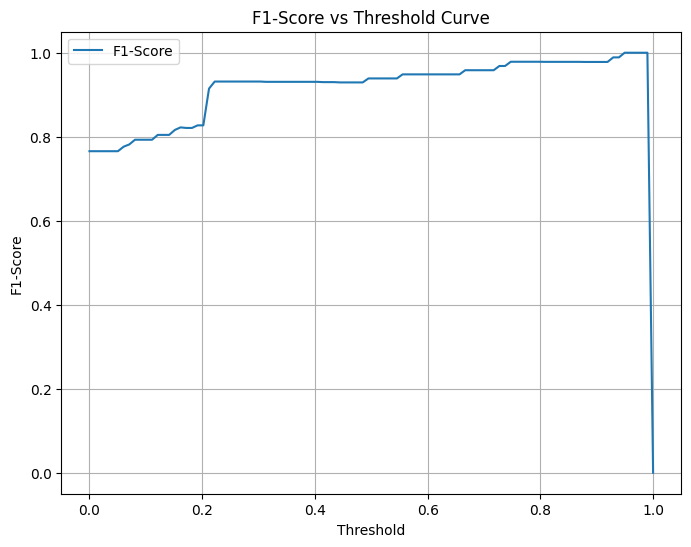

In [ ]:
# Function to evaluate the model and collect predictions and ground truths
def evaluate_model(model, dataloader, device):
    model.eval()  # Set the model to evaluation mode
    all_preds = []
    all_labels = []

    with torch.no_grad():  # No need for gradient computation during evaluation
        for images, targets in dataloader:
            images = [img.to(device) for img in images]
            outputs = model(images)

            # Collect ground truth and predictions for F1 curve calculation
            for i, output in enumerate(outputs):
                # Get predicted boxes and scores
                pred_boxes = output['boxes'].cpu().numpy()
                pred_scores = output['scores'].cpu().numpy()
                pred_labels = output['labels'].cpu().numpy()

                # Get true boxes and labels
                true_boxes = targets[i]['boxes'].cpu().numpy()
                true_labels = targets[i]['labels'].cpu().numpy()

                all_preds.append((pred_boxes, pred_scores, pred_labels))
                all_labels.append((true_boxes, true_labels))

    return all_preds, all_labels

# Function to compute precision, recall, and F1-score
def compute_f1_curve(all_preds, all_labels, num_classes=2):
    # Initialize arrays to store precision, recall, and f1 scores for each threshold
    f1_scores = []
    thresholds = np.linspace(0, 1, 100)  # Define thresholds from 0 to 1

    for threshold in thresholds:
        # Initialize lists to store true positives, false positives, false negatives
        all_true_positives = 0
        all_false_positives = 0
        all_false_negatives = 0

        for preds, labels in zip(all_preds, all_labels):
            pred_boxes, pred_scores, pred_labels = preds
            true_boxes, true_labels = labels

            # Filter predictions by threshold
            filtered_pred_labels = pred_labels[pred_scores >= threshold]

            # Count true positives, false positives, and false negatives
            true_positives = np.sum(filtered_pred_labels == true_labels)
            false_positives = np.sum(filtered_pred_labels != true_labels)
            false_negatives = np.sum(true_labels != filtered_pred_labels)

            all_true_positives += true_positives
            all_false_positives += false_positives
            all_false_negatives += false_negatives

        # Compute precision, recall, and F1 score
        precision = all_true_positives / (all_true_positives + all_false_positives + 1e-7)
        recall = all_true_positives / (all_true_positives + all_false_negatives + 1e-7)
        f1 = 2 * (precision * recall) / (precision + recall + 1e-7)
        f1_scores.append(f1)

    return thresholds, f1_scores

# Function to plot the F1-curve
def plot_f1_curve(thresholds, f1_scores):
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds, f1_scores, label='F1-Score')
    plt.xlabel('Threshold')
    plt.ylabel('F1-Score')
    plt.title('F1-Score vs Threshold Curve')
    plt.grid(True)
    plt.legend()
    plt.show()

# Run evaluation to get predictions and ground truth
all_preds, all_labels = evaluate_model(faster_rcnn_night, test_dataloader, device)

# Compute F1 curve
thresholds, f1_scores = compute_f1_curve(all_preds, all_labels)

# Plot the F1-curve
plot_f1_curve(thresholds, f1_scores)

# Test on night data

In [ ]:
url8 = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/train/WhatsApp-Image-2021-12-19-at-11-41-51-AM_jpeg.rf.6ba17e0ae34cc0292d34344b29a24933.jpg'
url9 = '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/train/WhatsApp-Image-2022-02-23-at-12-11-06-AM_jpeg.rf.85391e4ac3ac34924e5d25746dd065d5.jpg'


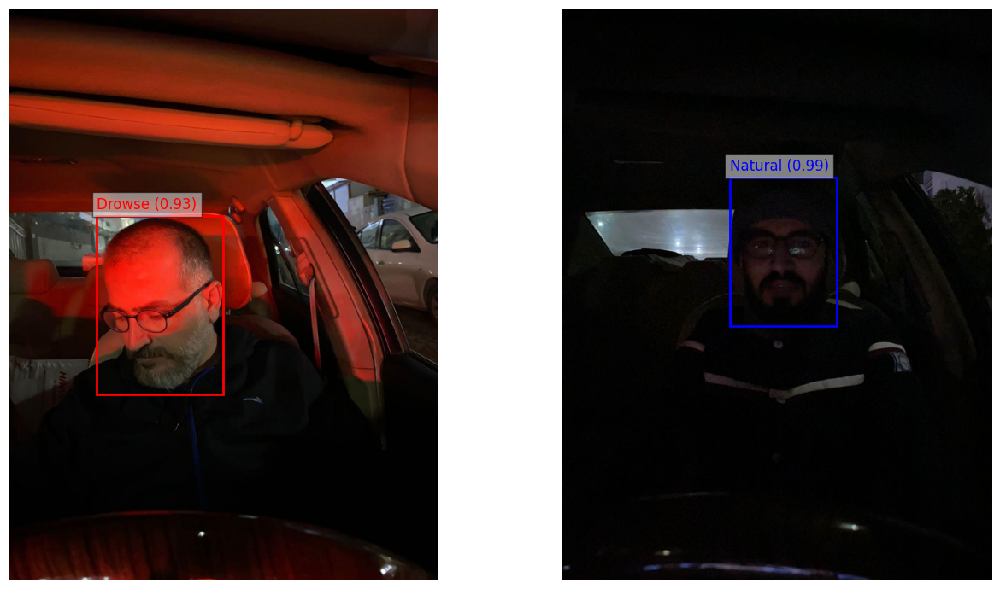

In [ ]:
plot_two_images_f_rcnn(url8,url9,faster_rcnn_night)

# Grad Cam faster  Night vision

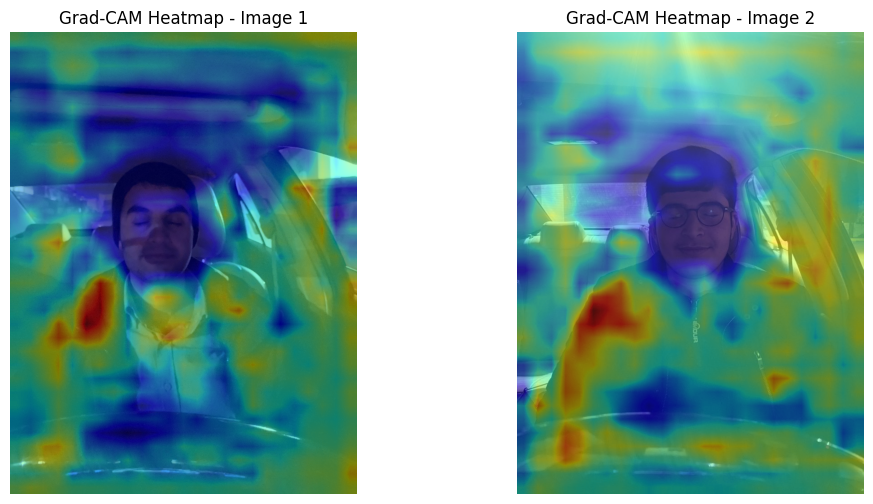

In [ ]:
# Ensure model is on GPU
faster_rcnn_night.to(device)

# Access the actual target layer from the model
target_layer = faster_rcnn_night.backbone.body.layer4

# Initialize Grad-CAM (make sure Grad-CAM handles model on the correct device)
grad_cam = GradCam(faster_rcnn_night, target_layer)

# Apply Grad-CAM for two images in the batch
for images, targets in test_dataloader:
    # Get two images from the batch
    image1 = images[0].to(device)  # Move image1 to the same device as the model (GPU)
    image2 = images[1].to(device)  # Move image2 to the same device as the model (GPU)

    # Enable gradient calculation for the forward pass
    with torch.enable_grad():
        # Get the Grad-CAM for both images (ensure forward pass is on the same device)
        cam1 = grad_cam(image1)
        cam2 = grad_cam(image2)

    # Rescale CAM to match the image size
    cam1 = cv2.resize(cam1, (image1.shape[2], image1.shape[1]))
    cam2 = cv2.resize(cam2, (image2.shape[2], image2.shape[1]))

    # Plot both Grad-CAM heatmaps side by side
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))

    axs[0].imshow(image1.permute(1, 2, 0).cpu().numpy())  # Original image 1
    axs[0].imshow(cam1, cmap='jet', alpha=0.5)  # Grad-CAM overlay 1
    axs[0].set_title('Grad-CAM Heatmap - Image 1')
    axs[0].axis('off')

    axs[1].imshow(image2.permute(1, 2, 0).cpu().numpy())  # Original image 2
    axs[1].imshow(cam2, cmap='jet', alpha=0.5)  # Grad-CAM overlay 2
    axs[1].set_title('Grad-CAM Heatmap - Image 2')
    axs[1].axis('off')

    plt.show()

    break  # Stop after the first batch for demonstration

# Trying to decrees df1 loss with After Adding Night data

In [ ]:
results = model.train(
   data='/kaggle/input/yaml-final/data.yaml',
   epochs=256,
   batch=16,
   name='yolov8s_final',
   )

In [ ]:
# Slice rows from 251 to 255
perfprmance3 = pd.read_csv("/content/drive/MyDrive/Drowse_Pro/src/yolov8s_final/results.csv")
result_slice = perfprmance3.iloc[251:256]  # .iloc for integer-based indexing
result_slice

,epoch,train/box_loss,train/cls_loss,train/dfl_loss,metrics/precision(B),metrics/recall(B),metrics/mAP50(B),metrics/mAP50-95(B),val/box_loss,val/cls_loss,val/dfl_loss,lr/pg0,lr/pg1,lr/pg2
251,252,0.20180,0.10275,0.77711,0.99183,0.99704,0.99460,0.97641,0.27609,0.14347,0.79658,0.000049,0.000049,0.000049
252,253,0.19905,0.10279,0.78617,0.99186,0.99710,0.99464,0.97588,0.27714,0.14138,0.79565,0.000042,0.000042,0.000042
253,254,0.19734,0.10083,0.78253,0.99199,0.99737,0.99461,0.97497,0.27686,0.14139,0.79577,0.000036,0.000036,0.000036
254,255,0.19444,0.09998,0.78127,0.99199,0.99736,0.99459,0.97471,0.27626,0.14104,0.79578,0.000030,0.000030,0.000030
255,256,0.19701,0.09989,0.78232,0.99199,0.99732,0.99461,0.97529,0.27583,0.14156,0.79613,0.000023,0.000023,0.000023


# Losses

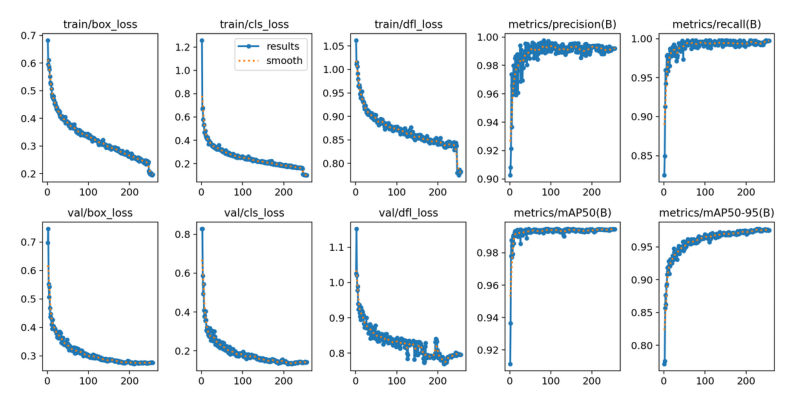

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_final/results.png"
plot_one_image(url)

# Model load

In [ ]:
yolo_final= YOLO(r'/content/drive/MyDrive/Drowse_Pro/src/yolov8s_final/weights/best.pt')

# Model Evaluation

* **Confusion matrix**

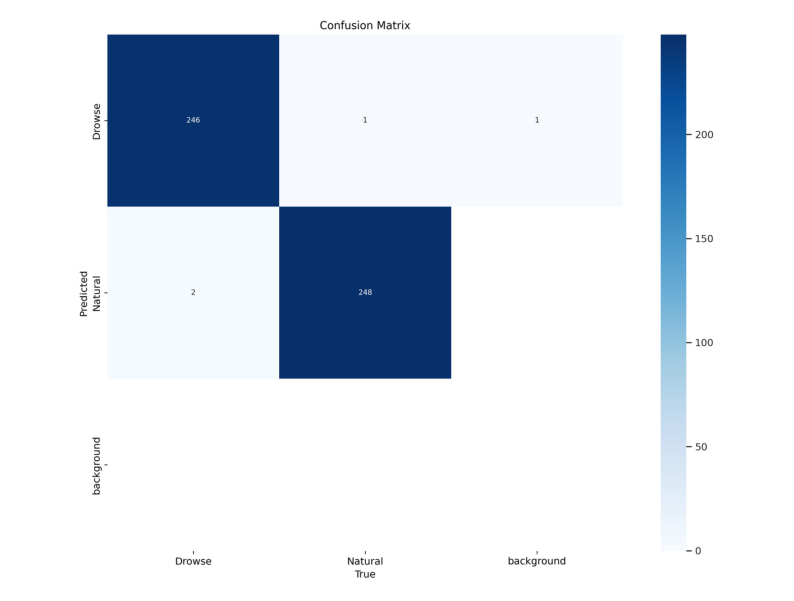

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_final/confusion_matrix.png"
plot_one_image(url)

* **F1 Curve**

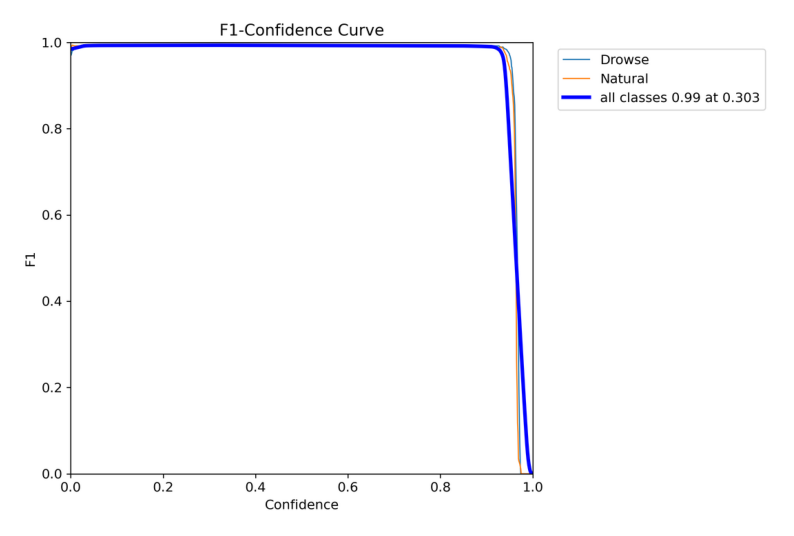

In [ ]:
url = "/content/drive/MyDrive/Drowse_Pro/src/yolov8s_final/F1_curve.png"
plot_one_image(url)

# Model Test on different data distributions


0: 384x640 1 Natural, 72.9ms
Speed: 2.9ms preprocess, 72.9ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Natural, 11.8ms
Speed: 2.9ms preprocess, 11.8ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Drowse, 12.0ms
Speed: 2.9ms preprocess, 12.0ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Natural, 11.6ms
Speed: 1.2ms preprocess, 11.6ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Drowse, 11.5ms
Speed: 1.1ms preprocess, 11.5ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 384x640 1 Natural, 11.6ms
Speed: 1.1ms preprocess, 11.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

0: 640x480 1 Natural, 39.6ms
Speed: 3.1ms preprocess, 39.6ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 480)

0: 640x480 1 Drowse, 13.2ms
Speed: 2.2ms preprocess, 13.2ms inference, 1.3ms postprocess per image at shape (1, 

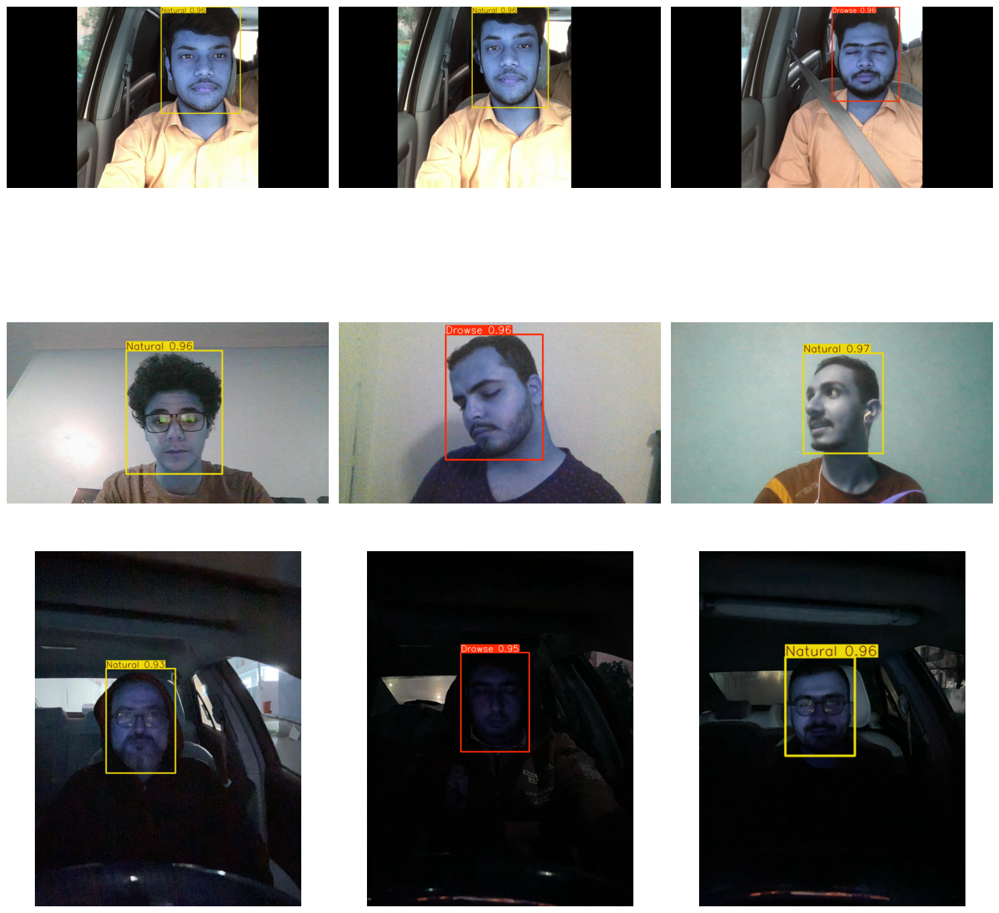

In [ ]:
images_paths = ['/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/63_jpg.rf.e7fe68dd2adff5d1f93b9a695d8e157b.jpg',
                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/aug_710_10_jpg.rf.f31e7196b06b7d98ea1fa398e60acb77.jpg',
                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/1730_jpg.rf.8e241bff0cef755cf00ddd4005f54588.jpg',

                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240913_23_40_57_Pro_jpg.rf.00812386eb3fea3d9b7487d01a270d7d.jpg',
                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_00_50_57_Pro_jpg.rf.b8afa0c0f4b9df6e0ec58fa6eab71710.jpg',
                '/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240914_00_55_00_Pro_jpg.rf.1d0c4439f1766ad8883843fe77e17b20.jpg',

                '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/test/96_jpeg.rf.1308590dd11459129aad9ef2fec708d0.jpg',
                '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/test/WhatsApp-Image-2022-02-23-at-12-12-41-AM-1-_jpeg.rf.c426d7a945b1dba0f76e34f3ec473bed.jpg',
                '/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/test/90-1-_jpeg.rf.add6d08e8ac485a9c539af75ea98d633.jpg']



plot_images(images_paths,yolo_final)

# Grad Cam

In [ ]:
target_layer = yolo_final.model.model[22].cv3[2] # This accesses the last convolutional layer in the third detection head.

In [ ]:
img = cv2.imread('/content/drive/MyDrive/Drowse_Pro/data_yolo/images/test/WIN_20240913_23_40_57_Pro_jpg.rf.00812386eb3fea3d9b7487d01a270d7d.jpg')
img = cv2.resize(img, (640, 640))
rgb_img = img.copy()
img = np.float32(img) / 255


img2 = cv2.imread('/content/drive/MyDrive/Drowse_Pro/night_data/night_data/images/test/96_jpeg.rf.1308590dd11459129aad9ef2fec708d0.jpg')
img2 = cv2.resize(img2, (640, 640))
rgb_img2 = img2.copy()
img2 = np.float32(img2) / 255


0: 640x640 1 Natural, 51.5ms
Speed: 2.6ms preprocess, 51.5ms inference, 3.9ms postprocess per image at shape (1, 3, 640, 640)

0: 640x640 1 Natural, 29.4ms
Speed: 7.8ms preprocess, 29.4ms inference, 1.8ms postprocess per image at shape (1, 3, 640, 640)


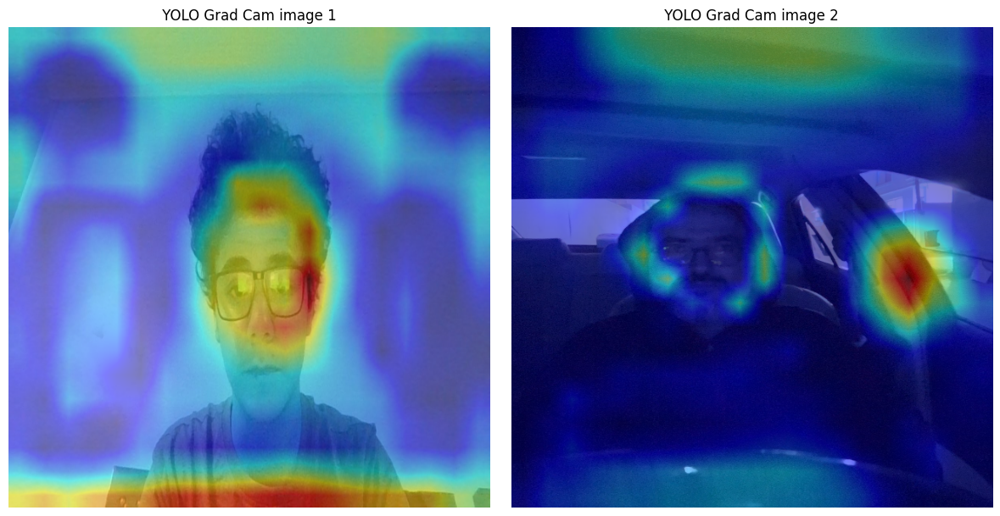

In [ ]:

# Display the images side by side using subplots
fig, ax = plt.subplots(1, 2, figsize=(12, 6))

# First CAM image
cam = EigenCAM(yolo_final, target_layer, task='od')
grayscale_cam = cam(rgb_img)[0, :, :]
cam_image = show_cam_on_image(img, grayscale_cam, use_rgb=True)

ax[0].imshow(cam_image)
ax[0].set_title(" YOLO Grad Cam image 1 ")
ax[0].axis('off')

# Second CAM image
cam2 = EigenCAM(yolo_final, target_layer, task='od')
grayscale_cam2 = cam2(rgb_img2)[0, :, :]
cam_image2 = show_cam_on_image(img2, grayscale_cam2, use_rgb=True)

ax[1].imshow(cam_image2)
ax[1].set_title(" YOLO Grad Cam image 2 ")
ax[1].axis('off')

# Display the images side by side
plt.tight_layout()
plt.show()

> # Faster RCNN works well in case of using PHONE but the YOLO sometimes can't handle this

# **SSD VGG16**

> # extract info from the data


In [ ]:
class COCODataset(Dataset):
    def __init__(self, root, annotation, transforms=None):
        self.root = root  # Root directory containing images
        self.coco = COCO(annotation)  # COCO annotation file
        self.ids = list(sorted(self.coco.imgs.keys()))  # List of all image ids
        self.transforms = transforms

    def __getitem__(self, idx):
        # Get the image id
        img_id = self.ids[idx]

        # Load the image
        img_info = self.coco.loadImgs(img_id)[0]
        img_path = os.path.join(self.root, img_info['file_name'])
        img = Image.open(img_path).convert("RGB")

        # Load annotations for the image
        ann_ids = self.coco.getAnnIds(imgIds=img_id)
        anns = self.coco.loadAnns(ann_ids)

        # Convert annotations into the target dictionary
        target = {}
        target["boxes"] = []
        target["labels"] = []
        for ann in anns:
            bbox = ann['bbox']
            # COCO format bbox is [x_min, y_min, width, height]
            # Convert to [x_min, y_min, x_max, y_max]
            x_min, y_min, width, height = bbox
            x_max = x_min + width
            y_max = y_min + height
            target["boxes"].append([x_min, y_min, x_max, y_max])
            target["labels"].append(ann['category_id'])

        target["boxes"] = torch.as_tensor(target["boxes"], dtype=torch.float32)
        target["labels"] = torch.as_tensor(target["labels"], dtype=torch.int64)

        # Apply transformations (only to the image)
        if self.transforms:
            img = self.transforms(img)  # Apply only on image

        return img, target

    def __len__(self):
        return len(self.ids)

    # Transformation function
def get_transform(train=True):
    transforms = []
    transforms.append(T.ToTensor())  # Convert image to tensor
    if train:
        # Apply random horizontal flip during training
        transforms.append(T.RandomHorizontalFlip(0.5))
    return T.Compose(transforms)


# Model preparation

In [ ]:
def create_model(num_classes=3, size=300, learning_rate=0.001):
    # Load the Torchvision pretrained SSD300 model with VGG16 backbone.
    model = torchvision.models.detection.ssd300_vgg16(
        weights=SSD300_VGG16_Weights.COCO_V1
    )

    # Retrieve the list of input channels for the backbone.
    in_channels = _utils.retrieve_out_channels(model.backbone, (size, size))

    # List containing number of anchors based on aspect ratios.
    num_anchors = model.anchor_generator.num_anchors_per_location()

    # The classification head - update it for the custom number of classes.
    model.head.classification_head = SSDClassificationHead(
        in_channels=in_channels,
        num_anchors=num_anchors,
        num_classes=num_classes,  # 2 classes (Drowse, Natural) + 1 background class
    )

    # Update the image size for transforms (if needed).
    model.transform.min_size = (size,)
    model.transform.max_size = size

    # Move the model to the GPU if available
    device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
    model.to(device)

    # Define the optimizer (AdamW) with the provided learning rate
    optimizer = torch.optim.AdamW(model.parameters(), lr=learning_rate)

    return model, optimizer

# Use the model for drowsiness detection with 2 classes (Drowse, Natural)
model, optimizer = create_model(num_classes=3, size=300, learning_rate=0.0001)

Downloading: "https://download.pytorch.org/models/ssd300_vgg16_coco-b556d3b4.pth" to /root/.cache/torch/hub/checkpoints/ssd300_vgg16_coco-b556d3b4.pth
100%|██████████| 136M/136M [00:02<00:00, 52.2MB/s]


> # Train dataloader

In [ ]:
# Usage example
root = '/content/drive/MyDrive/Drowse_Pro/final_data_coco/train_split'  # Path to the folder containing images
annotation = '/content/drive/MyDrive/Drowse_Pro/final_data_coco/train_split/_annotations.coco.json'  # Path to the COCO annotation file

# Create the dataset
dataset = COCODataset(root=root, annotation=annotation, transforms=get_transform())

# DataLoader to handle batching and shuffling
data_loader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=4, collate_fn=lambda x: tuple(zip(*x)))

loading annotations into memory...
Done (t=0.75s)
creating index...
index created!


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


># Model training 256 + 32 epoch

# this model trained befor for 256 epoch but the loss was high so we trained it for more 32 epoch

In [ ]:

# Number of epochs
num_epochs = 32

# Training loop
for epoch in range(num_epochs):
    model.train()  # Set model to training mode
    epoch_loss = 0

    for images, targets in data_loader:
        # Move images and targets to GPU
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # Forward pass
        loss_dict = model(images, targets)  # Loss dictionary from SSD
        losses = sum(loss for loss in loss_dict.values())  # Sum up all losses

        # Backward pass
        optimizer.zero_grad()  # Clear previous gradients
        losses.backward()  # Compute gradients
        optimizer.step()  # Update model parameters

        # Track epoch loss
        epoch_loss += losses.item()

    # Print the loss for the current epoch
    print(f"Epoch {epoch + 1}/{num_epochs}, Loss: {epoch_loss:.4f}")

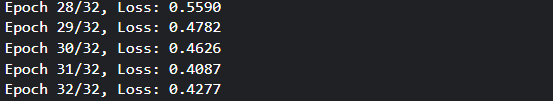

# Model save

In [ ]:
# Optionally: Save model checkpoint after each epoch
torch.save(model.state_dict(), f'ssd300_vgg16_v2.pth')

># Model Load

In [ ]:
# Function to load the state_dict into the model
def load_model_weights(model, state_dict_path):
    # Load the saved state_dict
    state_dict = torch.load(state_dict_path)

    # Load the state_dict into the model
    model.load_state_dict(state_dict)

    print("Model weights loaded successfully.")

# Use the model for drowsiness detection with 2 classes (Drowse, Natural)
model, optimizer = create_model(num_classes=3, size=300, learning_rate=0.0001)


# Load the trained weights (adjust the path to where your weights are saved)
checkpoint_path = '/content/drive/MyDrive/Drowse_Pro/src/ssd300_vgg16_v2.pth'  # Replace with your trained model path
model.load_state_dict(torch.load(checkpoint_path))

# Set the model to evaluation mode
model.eval()

# Move the model to the correct device (CPU or GPU)
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
model.to(device)

SSD(
  (backbone): SSDFeatureExtractorVGG(
    (features): Sequential(
      (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): ReLU(inplace=True)
      (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (3): ReLU(inplace=True)
      (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (6): ReLU(inplace=True)
      (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): ReLU(inplace=True)
      (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
      (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): ReLU(inplace=True)
      (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (13): ReLU(inplace=True)
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (15): ReLU(inplace=

# test data loader

In [ ]:
# Usage example
root = '/content/drive/MyDrive/Drowse_Pro/final_data_coco/test_split'  # Path to the folder containing images
annotation = '/content/drive/MyDrive/Drowse_Pro/final_data_coco/test_split/_annotations.coco.json'  # Path to the COCO annotation file

# Create the dataset
dataset = COCODataset(root=root, annotation=annotation, transforms=get_transform())

# DataLoader to handle batching and shuffling
test_data_loader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=4, collate_fn=lambda x: tuple(zip(*x)))

loading annotations into memory...
Done (t=0.42s)
creating index...
index created!


/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


> # Model Evaluation  

# **Confusion matrix**

Length of y_true: 497, Length of y_pred: 497


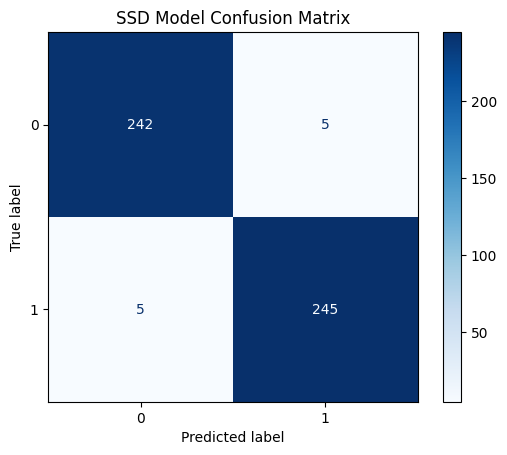

In [ ]:
# Set the model to evaluation mode
model.eval()

# Initialize lists to store true labels and predicted labels
y_true = []
y_pred = []

# Loop over the test data to get predictions
with torch.no_grad():
    for images, targets in test_data_loader:
        # Move images to the device (GPU or CPU)
        images = [image.to(device) for image in images]

        # Get the predictions from the SSD model
        outputs = model(images)

        # Loop through each image and extract the predictions and true labels
        for i, output in enumerate(outputs):
            preds = output['labels'].cpu().numpy()  # Predicted labels by the model

            # Access true labels - assuming targets[i] is a dictionary with 'labels' or similar key
            if isinstance(targets[i], dict):
                true = targets[i]['labels'].cpu().numpy()  # Modify this line as needed based on the structure
            else:
                true = [obj['category_id'] for obj in targets[i]]  # COCO-style annotation

            # Ensure the lengths match - Adjust predictions and true labels
            min_len = min(len(preds), len(true))  # Take only the matched number of labels
            y_pred.extend(preds[:min_len])
            y_true.extend(true[:min_len])

# Check the lengths of y_true and y_pred
print(f"Length of y_true: {len(y_true)}, Length of y_pred: {len(y_pred)}")

# Generate confusion matrix
cm = confusion_matrix(y_true, y_pred)

# Plot confusion matrix
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
disp.plot(cmap=plt.cm.Blues)
plt.title('SSD Model Confusion Matrix')
plt.show()

# **F1 Curve**

/usr/local/lib/python3.10/dist-packages/torch/utils/data/dataloader.py:557: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(_create_warning_msg(


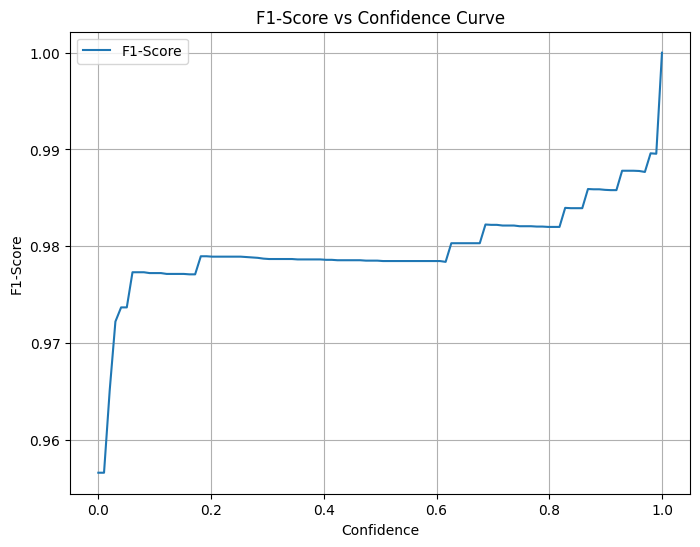

In [ ]:
# Function to evaluate the model and collect predictions and ground truths
def evaluate_model(model, dataloader, device):
    model.eval()  # Set the model to evaluation mode
    all_preds = []
    all_labels = []

    with torch.no_grad():  # No need for gradient computation during evaluation
        for images, targets in dataloader:
            images = [img.to(device) for img in images]
            outputs = model(images)

            # Collect ground truth and predictions for F1 curve calculation
            for i, output in enumerate(outputs):
                # Get predicted boxes and scores
                pred_boxes = output['boxes'].cpu().numpy()
                pred_scores = output['scores'].cpu().numpy()
                pred_labels = output['labels'].cpu().numpy()

                # Get true boxes and labels
                true_boxes = targets[i]['boxes'].cpu().numpy()
                true_labels = targets[i]['labels'].cpu().numpy()

                all_preds.append((pred_boxes, pred_scores, pred_labels))
                all_labels.append((true_boxes, true_labels))

    return all_preds, all_labels

# Function to compute precision, recall, and F1-score
def compute_f1_curve(all_preds, all_labels, num_classes=2):
    # Initialize arrays to store precision, recall, and f1 scores for each threshold
    f1_scores = []
    thresholds = np.linspace(0, 1, 100)  # Define thresholds from 0 to 1

    for threshold in thresholds:
        # Initialize lists to store true positives, false positives, false negatives
        all_true_positives = 0
        all_false_positives = 0
        all_false_negatives = 0

        for preds, labels in zip(all_preds, all_labels):
            pred_boxes, pred_scores, pred_labels = preds
            true_boxes, true_labels = labels

            # Filter predictions by threshold
            filtered_pred_labels = pred_labels[pred_scores >= threshold]

            # Count true positives, false positives, and false negatives
            true_positives = np.sum(filtered_pred_labels == true_labels)
            false_positives = np.sum(filtered_pred_labels != true_labels)
            false_negatives = np.sum(true_labels != filtered_pred_labels)

            all_true_positives += true_positives
            all_false_positives += false_positives
            all_false_negatives += false_negatives

        # Compute precision, recall, and F1 score
        precision = all_true_positives / (all_true_positives + all_false_positives + 1e-7)
        recall = all_true_positives / (all_true_positives + all_false_negatives + 1e-7)
        f1 = 2 * (precision * recall) / (precision + recall + 1e-7)
        f1_scores.append(f1)

    return thresholds, f1_scores

# Function to plot the F1-curve
def plot_f1_curve(thresholds, f1_scores):
    plt.figure(figsize=(8, 6))
    plt.plot(thresholds, f1_scores, label='F1-Score')
    plt.xlabel('Confidence')
    plt.ylabel('F1-Score')
    plt.title('F1-Score vs Confidence Curve')
    plt.grid(True)
    plt.legend()
    plt.show()

# Run evaluation to get predictions and ground truth
all_preds, all_labels = evaluate_model(model, test_data_loader, device)

# Compute F1 curve
thresholds, f1_scores = compute_f1_curve(all_preds, all_labels)

# Plot the F1-curve
plot_f1_curve(thresholds, f1_scores)

> # Model Compression

# before


In [ ]:
# Device setup
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

# Load the YOLOv8s model
yolov8s = YOLO('/kaggle/input/models/pytorch/default/1/yolo_final.pt')
yolov8s.to(device)  # Move YOLOv8 to device

# Load the pretrained Faster R-CNN model and modify for custom classes
faster_rcnn = torchvision.models.detection.fasterrcnn_resnet50_fpn(pretrained=True)
num_classes = 3  # Adjust based on your dataset
in_features = faster_rcnn.roi_heads.box_predictor.cls_score.in_features
faster_rcnn.roi_heads.box_predictor = torchvision.models.detection.faster_rcnn.FastRCNNPredictor(in_features, num_classes)

# Load the custom weights for Faster R-CNN
model_path = '/kaggle/input/models/pytorch/default/1/faster_Rcnn_night.pth'
faster_rcnn.load_state_dict(torch.load(model_path, map_location=device))
faster_rcnn.to(device)  # Move Faster R-CNN to device

# Function to count model parameters for YOLOv8s
def count_yolo_parameters(model):
    total_params = 0
    for param in model.parameters():
        total_params += param.numel()
    return total_params

# Get the number of parameters for both models
params_yolov8s = count_yolo_parameters(yolov8s.model)
params_faster_rcnn = sum(p.numel() for p in faster_rcnn.parameters() if p.requires_grad)

# Function to format parameter count into readable string
def format_param_count(count):
    if count >= 1_000_000:
        return f"{count / 1_000_000:.2f}M"
    elif count >= 1_000:
        return f"{count / 1_000:.2f}K"
    else:
        return str(count)

# Create a DataFrame to store the results
results_df = pd.DataFrame({
    'Model': ['YOLOv8s', 'Faster R-CNN'],
    'Parameters (Millions)': [params_yolov8s / 1_000_000, params_faster_rcnn / 1_000_000],
    'Inference Time (per frame) (seconds)': [None, None],  # Placeholder for inference times
    'FPS': [None, None]  # Placeholder for FPS
})

# Function to measure inference time on a test video
def measure_inference_time(model, video_path, device, input_size=(640, 640)):
    # Load the test video
    cap = cv2.VideoCapture(video_path)
    total_time = 0
    frame_count = 0

    # Set model to evaluation mode
    model.eval()

    while cap.isOpened():
        ret, frame = cap.read()
        if not ret:
            break

        # Preprocess frame for model (resize to the model's expected input size)
        image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        image = cv2.resize(image, input_size)  # Resize to (640, 640) for YOLOv8
        image = torch.from_numpy(image).permute(2, 0, 1).float().to(device) / 255.0
        image = image.unsqueeze(0)

        # Measure time for inference
        start_time = time.time()
        with torch.no_grad():
            outputs = model(image)
        end_time = time.time()

        total_time += end_time - start_time
        frame_count += 1

    cap.release()

    # Return average time per frame and total frames processed
    avg_time_per_frame = total_time / frame_count if frame_count > 0 else 0
    fps = frame_count / total_time if total_time > 0 else 0
    return avg_time_per_frame, fps

# Test video path
video_path = "/kaggle/input/test-videos/omar_morning.mp4"

# Measure speed (inference time) and FPS for YOLOv8s
yolov8s_speed, yolov8s_fps = measure_inference_time(yolov8s.model, video_path, device)
# Measure speed (inference time) and FPS for Faster R-CNN
faster_rcnn_speed, faster_rcnn_fps = measure_inference_time(faster_rcnn, video_path, device)

# Update the DataFrame with inference times and FPS
results_df.loc[0, 'Inference Time (per frame) (seconds)'] = yolov8s_speed
results_df.loc[0, 'FPS'] = yolov8s_fps
results_df.loc[1, 'Inference Time (per frame) (seconds)'] = faster_rcnn_speed
results_df.loc[1, 'FPS'] = faster_rcnn_fps

# Print the results DataFrame
results_df


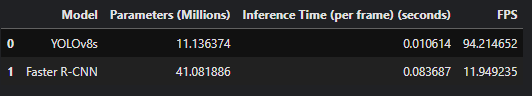

In [ ]:
# Plot comparison
labels = ['YOLOv8s', 'Faster R-CNN']
params = [params_yolov8s, params_faster_rcnn]
speed = [yolov8s_speed, faster_rcnn_speed]

fig, ax1 = plt.subplots(figsize=(10, 6))

# Bar chart for Parameters
ax1.set_xlabel('Model')
ax1.set_ylabel('Number of Parameters', color='tab:blue')
ax1.bar(labels, params, color='tab:blue', label='Parameters')
ax1.tick_params(axis='y', labelcolor='tab:blue')

# Line chart for Inference Time
ax2 = ax1.twinx()
ax2.set_ylabel('Inference Time (seconds)', color='tab:red')
ax2.plot(labels, speed, color='tab:red', marker='o', label='Inference Time')
ax2.tick_params(axis='y', labelcolor='tab:red')

fig.tight_layout()
plt.title('Before Model Comparison: Parameters and Inference Time')
plt.show()

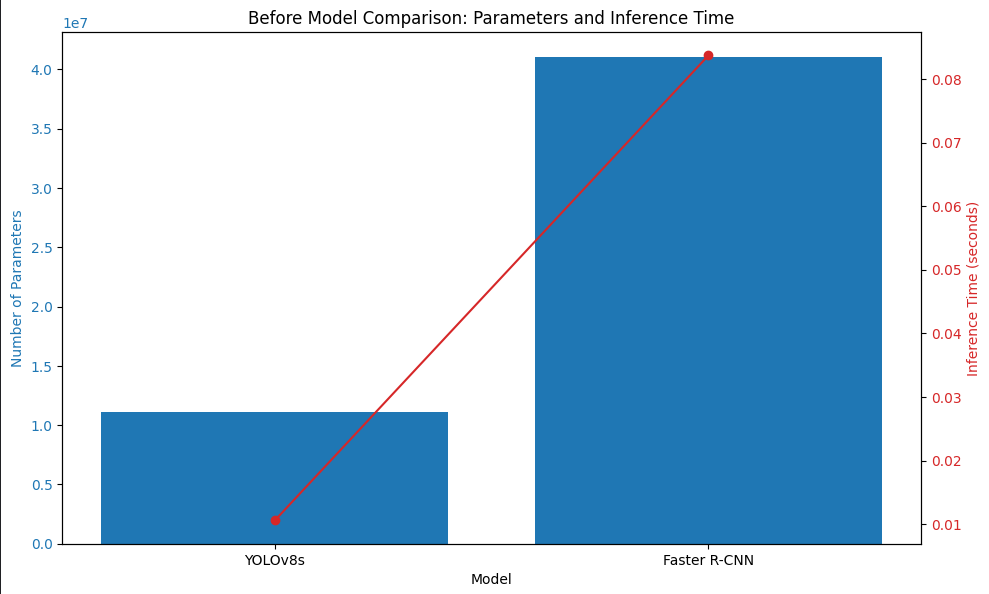

# After

# Quantization using tensorrt

In [ ]:
yolov8s = YOLO('/content/drive/MyDrive/Drowse_Pro/src/yolov8s_final/weights/best.pt')
# Export the model to TensorRT format
yolov8s.export(format="engine", half=True, device=device.index, workspace=12)  # Adjust parameters as needed

In [ ]:
# Download modules
!gdown https://drive.google.com/uc?id=1RskX1wXVF0xSMAPgpkU-EsaUv8tD7lvS

Downloading...
From: https://drive.google.com/uc?id=1RskX1wXVF0xSMAPgpkU-EsaUv8tD7lvS
To: /content/modules.zip
100% 5.79k/5.79k [00:00<00:00, 19.3MB/s]


In [ ]:
# Unzip the modules
!unzip modules.zip

Archive:  modules.zip
  inflating: modules/autobackend.py  
  inflating: modules/utils.py        


In [ ]:
!pip install tensorrt

# compare speed and FPS on a video

In [ ]:
def tensorrt_detection(model, source, image):
    # Preprocess
    im = utils.preprocess(image)

    # Inference
    preds = model(im)

    # Post Process
    results = utils.postprocess(preds, im, image, model.names, source)
    d = results[0].boxes

    # Get information from result
    tensor_size = d.cls.size()[0]
    if(tensor_size > 1):
        cls, conf, box = d.cls.squeeze(), d.conf.squeeze(), d.xyxy.squeeze()
    else:
        cls, conf, box = d.cls, d.conf, d.xyxy

    return cls, conf, box

def yolov8_detection(model, image):
    # Update object localizer
    results = model.predict(image, imgsz=640, conf=0.5, verbose=False)
    result = results[0].cpu()

    # Get information from result
    box = result.boxes.xyxy.numpy()
    conf = result.boxes.conf.numpy()
    cls = result.boxes.cls.numpy().astype(int)

    return cls, conf, box

def detection(model_path, source, name):
  # Check File Extension
  file_extension = pathlib.Path(model_path).suffix

  if(file_extension == ".engine"):
    model = AutoBackend(model_path, device=torch.device('cuda:0'), fp16=True)
    # Warmup
    model.warmup()
  else:
    model = YOLO(model_path)

  # Class Name and Colors
  label_map = model.names
  COLORS = [[random.randint(0, 255) for _ in range(3)] for _ in label_map]

  # FPS Detection
  frame_count = 0
  total_fps = 0
  avg_fps = 0

  # FPS Video
  video_cap = cv2.VideoCapture(source)

  total_frames = int(video_cap.get(cv2.CAP_PROP_FRAME_COUNT))
  frame_width = int(video_cap.get(3))
  frame_height = int(video_cap.get(4))

  video_frames = []

  while video_cap.isOpened():
      ret, frame = video_cap.read()
      if not ret:
          break

      # # Start Time
      start = time.time()

      # Detection
      if(file_extension == ".engine"):
        cls, conf, box = tensorrt_detection(model, source, frame)
      else:
        cls, conf, box = yolov8_detection(model, frame)

      # Pack together for easy use
      detection_output = list(zip(cls, conf, box))
      image_output = utils.draw_box(frame, detection_output, label_map, COLORS)

      end = time.time()
      # # End Time

      # Draw FPS
      frame_count += 1
      fps = 1 / (end - start)
      total_fps = total_fps + fps
      avg_fps = total_fps / frame_count

      image_output = utils.draw_fps(avg_fps, image_output)

      # Append frame to array
      video_frames.append(image_output)

      #
      print("(%2d / %2d) Frames Processed" % (frame_count, total_frames))

  print(avg_fps)

  # Get a file name
  file_name = utils.get_name(source)
  # Get Save Path
  folder_name = name
  save_path = utils.get_save_path(file_name, folder_name)
  # Create VideoWriter object.
  out = cv2.VideoWriter(save_path, cv2.VideoWriter_fourcc(*'XVID'), int(avg_fps), (frame_width, frame_height))

  for frame in video_frames:
      out.write(frame)

  out.release()

  print("Video is saved in: "+save_path)

In [ ]:
detection("/content/yolo_final.pt", "/content/omar_morning.mp4", "detection-yolov8/orginal")

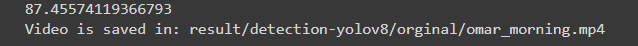

In [ ]:
detection("/content/yolov8s_model.engine", "/content/omar_morning.mp4", "detection-yolov8/comp")

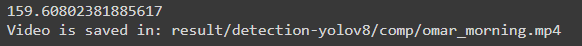

# Comparison

In [ ]:
# Data
data = {
    'Stage': ['Before Quantization', 'After Quantization'],
    'FPS': [87.45574119366793, 159.60802381885617],
    'Processing Time (s)': [18, 10],
    'Video len (s)' : [55 , 55]
}

# Create DataFrame
df = pd.DataFrame(data)

df

,Stage,FPS,Processing Time (s),Video len (s)
0,Before Quantization,87.455741,18,55
1,After Quantization,159.608024,10,55


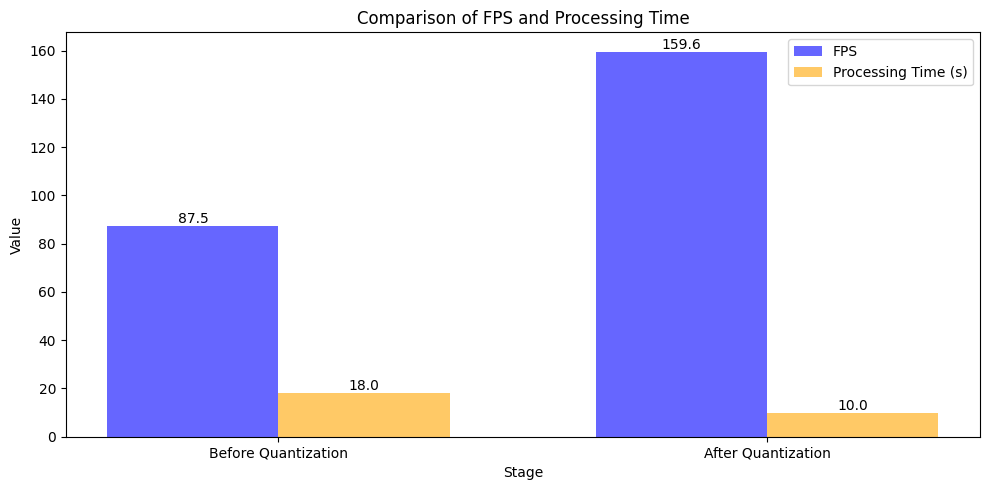

In [ ]:
# Set the figure size
plt.figure(figsize=(10, 5))

# Create a bar plot for FPS and Processing Time
bar_width = 0.35
x = range(len(df))

# Plot FPS
fps_bars = plt.bar(x, df['FPS'], width=bar_width, label='FPS', color='blue', alpha=0.6)

# Plot Processing Time
pt_bars = plt.bar([p + bar_width for p in x], df['Processing Time (s)'], width=bar_width, label='Processing Time (s)', color='orange', alpha=0.6)

# Adding labels and title
plt.xlabel('Stage')
plt.xticks([p + bar_width / 2 for p in x], df['Stage'])
plt.ylabel('Value')
plt.title('Comparison of FPS and Processing Time')
plt.legend()

# Annotate FPS bars
for bar in fps_bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, f'{yval:.1f}', ha='center', va='bottom')

# Annotate Processing Time bars
for bar in pt_bars:
    yval = bar.get_height()
    plt.text(bar.get_x() + bar.get_width()/2, yval, f'{yval:.1f}', ha='center', va='bottom')

# Show the plot
plt.tight_layout()
plt.show()

# Test on image or a video

In [ ]:
!yolo predict model=/content/yolov8s_model.engine source=/content/omar_morning.mp4 # source is an image or video

# 3 models size comaprizon

In [ ]:
# Function to get model file size in MB
def get_model_file_size(file_path):
    return os.path.getsize(file_path) / (2 ** 20)  # Convert to MB

# Paths to your compressed model files
yolov8_path = '/content/yolov8s_model.engine'
faster_rcnn_path = '/content/faster_Rcnn_night.pth'
ssd_model_path = '/content/ssd300_vgg16_v2.pth'

# Get the model sizes in MB
yolov8_size_mb = get_model_file_size(yolov8_path)
faster_rcnn_size_mb = get_model_file_size(faster_rcnn_path)
ssd_model_size_mb = get_model_file_size(ssd_model_path)

# Convert sizes to GB for additional display (optional)
yolov8_size_gb = yolov8_size_mb / 1024
faster_rcnn_size_gb = faster_rcnn_size_mb / 1024
ssd_model_size_gb = ssd_model_size_mb / 1024

# Print sizes in MB and GB
print(f"YOLOv8 Model Size: {yolov8_size_mb:.2f} MB ({yolov8_size_gb:.2f} GB)")
print(f"Faster R-CNN Model Size: {faster_rcnn_size_mb:.2f} MB ({faster_rcnn_size_gb:.2f} GB)")
print(f"SSD300 Model Size: {ssd_model_size_mb:.2f} MB ({ssd_model_size_gb:.2f} GB)")

# Data for plotting
model_names = ['YOLOv8', 'Faster R-CNN', 'SSD300']
model_sizes_mb = [yolov8_size_mb, faster_rcnn_size_mb, ssd_model_size_mb]

# Plotting the model sizes
plt.figure(figsize=(10, 6))
plt.bar(model_names, model_sizes_mb, color=['blue', 'orange', 'green'])
plt.title('Model Sizes Comparison')
plt.xlabel('Model')
plt.ylabel('Size (MB)')
plt.grid(axis='y')

# Show the plot
plt.show()

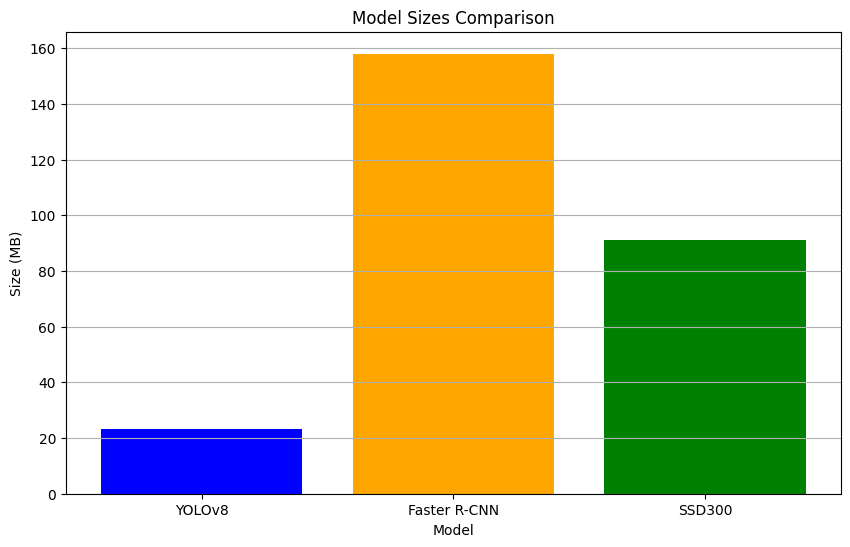

In [ ]:
# Model names and sizes in MB and GB
data = {
    "Model": ["YOLOv8", "Faster R-CNN", "SSD300"],
    "Size (MB)": [23.07, 158.07, 91.12],
    "Size (GB)": [0.02, 0.15, 0.09]
}

# Create a DataFrame
df = pd.DataFrame(data)


# Optionally, display it as a pretty table (if you are in a Jupyter Notebook or similar environment)
df.style.set_caption("Model Size Comparison").background_gradient(cmap='Blues')

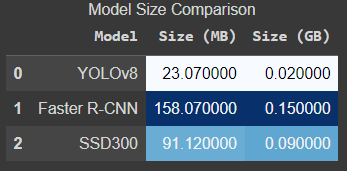

# YOlo before compression VS after compression

In [ ]:
# Function to get model file size in MB
def get_model_file_size(file_path):
    return os.path.getsize(file_path) / (2 ** 20)  # Convert to MB

# Paths to your original and compressed YOLO models
yolov8_original_path = '/content/yolo_final.pt'  # Path to original YOLOv8 model
yolov8_compressed_path = '/content/yolov8s_model.engine'  # Path to compressed YOLOv8 model

# Get the model sizes in MB
yolov8_original_size_mb = get_model_file_size(yolov8_original_path)
yolov8_compressed_size_mb = get_model_file_size(yolov8_compressed_path)

# Convert sizes to GB for additional display (optional)
yolov8_original_size_gb = yolov8_original_size_mb / 1024
yolov8_compressed_size_gb = yolov8_compressed_size_mb / 1024

# Print sizes in MB and GB
print(f"YOLOv8 Original Model Size: {yolov8_original_size_mb:.2f} MB ({yolov8_original_size_gb:.2f} GB)")
print(f"YOLOv8 Compressed Model Size: {yolov8_compressed_size_mb:.2f} MB ({yolov8_compressed_size_gb:.2f} GB)")

# Data for plotting
model_names = ['YOLOv8 Original', 'YOLOv8 Compressed']
model_sizes_mb = [yolov8_original_size_mb, yolov8_compressed_size_mb]

# Plotting the model sizes
plt.figure(figsize=(10, 6))
plt.bar(model_names, model_sizes_mb, color=['blue', 'orange'])
plt.title('YOLOv8 Model Sizes Comparison')
plt.xlabel('Model')
plt.ylabel('Size (MB)')
plt.grid(axis='y')

# Show the plot
plt.show()

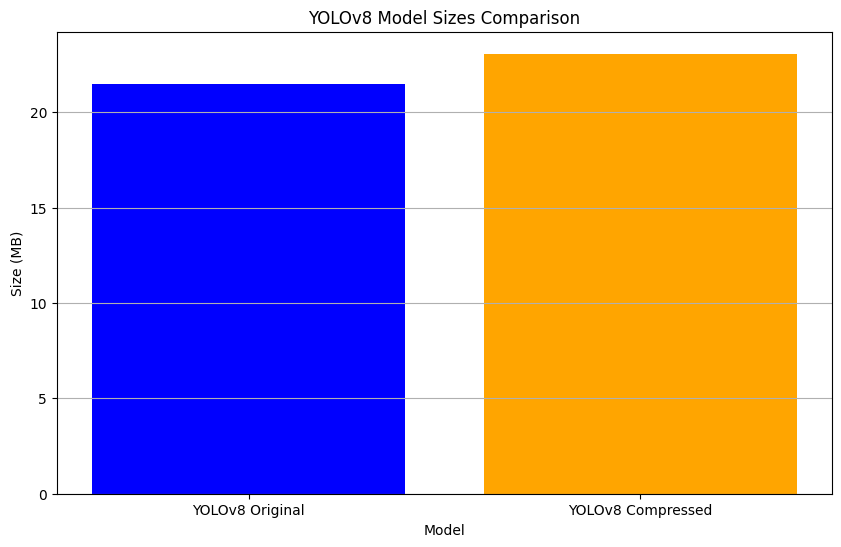

In [ ]:
data = {
    'Model': ['YOLOv8 Original', 'YOLOv8 Compressed'],
    'Size (MB)': [21.51, 23.07],
    'Size (GB)': [0.02, 0.02]
}

# Create the DataFrame
model_sizes_df = pd.DataFrame(data)

# Style the DataFrame with a caption and a blue gradient
styled_df = (model_sizes_df.style
             .set_caption("Model Size Comparison")  # Set table caption
             .background_gradient(cmap='Blues')  # Apply a light blue gradient
             .highlight_max(color='bkue', subset=['Size (MB)'])  # Highlight max value with a light color
            )

# Display the styled DataFrame
styled_df

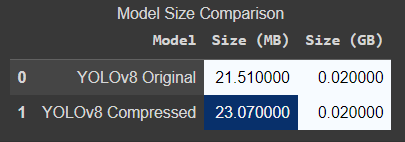

# Test with videos

* **YOLO**

In [ ]:
# # Load the video
# video_path = '/content/Ali_test.mp4'  # Replace with your video path
# cap = cv2.VideoCapture(video_path)

# # Get video details
# width  = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))   # Get the width of the frame
# height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))  # Get the height of the frame
# fps = cap.get(cv2.CAP_PROP_FPS)                   # Get the FPS of the video

# # Define VideoWriter to save the output video
# output_video_path = '/content/output_video.mp4'  # Output video path
# fourcc = cv2.VideoWriter_fourcc(*'mp4v')         # Codec for .mp4
# out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

# # Process video frames
# while cap.isOpened():
#     ret, frame = cap.read()
#     if not ret:
#         break

#     # YOLO inference on each frame
#     results = yolo_night(frame)

#     # Annotate the frame with bounding boxes and labels
#     annotated_frame = results[0].plot()  # Plot the results with bounding boxes

#     # Write the annotated frame to the output video
#     out.write(annotated_frame)

#     # Optionally display the frame (comment this if running in headless mode)
#     # cv2.imshow('YOLOv8 Inference', annotated_frame)
#     # if cv2.waitKey(1) & 0xFF == ord('q'):
#     #     break

# # Release resources
# cap.release()
# out.release()
# cv2.destroyAllWindows()

# print(f"Video saved to {output_video_path}")

* **Faster RCNN**

In [ ]:
# # Class names for the labels
# class_names = {0: 'background', 1: 'Drowse', 2: 'Natural'}

# # Set up the device
# device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')

# # Move the model to the correct device
# faster_rcnn_night.eval()
# faster_rcnn_night.to(device)

# # Load the video
# video_path = '/kaggle/input/amr-vid2/amr_test.mp4'  # Replace with your video path
# cap = cv2.VideoCapture(video_path)

# # Get video details
# width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
# height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
# fps = cap.get(cv2.CAP_PROP_FPS)

# # Define VideoWriter to save the output video
# output_video_path = '/kaggle/working/output_video.mp4'
# fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for .mp4
# out = cv2.VideoWriter(output_video_path, fourcc, fps, (width, height))

# # Preprocessing for each frame (normalization, resizing, etc.)
# transform = T.Compose([T.ToTensor()])

# # Define a function to draw bounding boxes and class names on frames
# def draw_boxes_on_frame(frame, predictions, threshold=0.86):
#     boxes = predictions['boxes'].cpu().detach().numpy()
#     scores = predictions['scores'].cpu().detach().numpy()
#     labels = predictions['labels'].cpu().detach().numpy()

#     for i, (box, score, label) in enumerate(zip(boxes, scores, labels)):
#         if score >= threshold:  # Filter predictions by confidence threshold
#             x1, y1, x2, y2 = map(int, box)

#              # Draw the bounding box
#             cv2.rectangle(frame, (x1, y1), (x2, y2), (0, 255, 0), 2)

#             # Get the class name for the label
#             class_name = class_names.get(label, 'Unknown')

#             # Add the class name and confidence score on top of the box with larger font size
#             label_text = f"{class_name}: {score:.2f}"

#             # Increase the font scale for larger text
#             font_scale = 2.0  # Adjust this value for larger or smaller text
#             font_thickness = 2  # Thickness of the text

#             cv2.putText(frame, label_text, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, font_scale, (0, 255, 0), font_thickness)

#     return frame

# # Read video frames and process them
# while cap.isOpened():
#     ret, frame = cap.read()
#     if not ret:
#         break

#     # Convert the frame to tensor and add a batch dimension
#     frame_tensor = transform(frame).unsqueeze(0).to(device)

#     # Get predictions from the Faster R-CNN model
#     with torch.no_grad():
#         predictions = faster_rcnn_night(frame_tensor)[0]

#     # Draw bounding boxes and labels on the frame
#     annotated_frame = draw_boxes_on_frame(frame, predictions)

#     # Write the annotated frame to the output video
#     out.write(annotated_frame)

#     # Optionally display the frame (for testing purposes)
#     # cv2.imshow('Faster R-CNN Inference', annotated_frame)
#     # if cv2.waitKey(1) & 0xFF == ord('q'):
#     #     break

# # Release resources
# cap.release()
# out.release()

# # Remove this line in headless environments
# # cv2.destroyAllWindows()

# print(f"Annotated video saved to {output_video_path}")

* **SSD**

In [ ]:
# # Create an output directory for saving the video
# output_dir = '/kaggle/working/'
# os.makedirs(output_dir, exist_ok=True)

# # Function to run inference on each frame and save results to a video file
# def process_video(video_path, output_path):
#     cap = cv2.VideoCapture(video_path)

#     # Get the original video properties
#     width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
#     height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
#     fps = int(cap.get(cv2.CAP_PROP_FPS))

#     # Define the codec and create a VideoWriter object to save the output video
#     fourcc = cv2.VideoWriter_fourcc(*'mp4v')  # Codec for saving as mp4
#     out = cv2.VideoWriter(output_path, fourcc, fps, (width, height))

#     # Class mapping
#     class_names = {1: "Drowse", 2: "Natural"}

#     while cap.isOpened():
#         ret, frame = cap.read()
#         if not ret:
#             break

#         # Convert frame to PIL image
#         frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
#         frame_pil = Image.fromarray(frame_rgb)

#         # Preprocess the frame
#         img_tensor = F.to_tensor(frame_pil).unsqueeze(0).to(device)

#         # Run inference
#         with torch.no_grad():
#             predictions = model(img_tensor)

#         # Extract predictions
#         pred_boxes = predictions[0]['boxes'].cpu().numpy()
#         pred_labels = predictions[0]['labels'].cpu().numpy()
#         pred_scores = predictions[0]['scores'].cpu().numpy()

#         # Draw the results on the frame
#         for i, box in enumerate(pred_boxes):
#             if pred_scores[i] > 0.86:  # Confidence threshold
#                 # Get box coordinates
#                 xmin, ymin, xmax, ymax = map(int, box)

#                 # Draw the bounding box
#                 cv2.rectangle(frame, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)

#                 # Get the class name from the mapping
#                 class_name = class_names.get(pred_labels[i], "Unknown")
#                 label = f"{class_name}: {pred_scores[i]:.2f}"

#                 # Add label text
#                 cv2.putText(frame, label, (xmin, ymin - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (0, 255, 0), 2)

#         # Write the processed frame to the output video
#         out.write(frame)

#     cap.release()
#     out.release()
#     print(f"Processed video saved at: {output_path}")

# # Test the model on a video file and save the output
# video_path = '/kaggle/input/test-videos/amr_evening.mp4'  # Replace with your input video path
# output_path = os.path.join(output_dir, 'ssd_amr_evening.mp4')
# process_video(video_path, output_path)